
### Com os embeddings criados, o próximo desafio é mapear e identificar onde, dentro dessas representações, cada pilar-chave está localizado — como cor, estampa e modelagem.

A ideia é analisar como essas características se manifestam no espaço vetorial dos embeddings. Precisamos descobrir em quais subespaços específicos cada atributo se concentra, de forma que, por exemplo, cores semelhantes tenham vetores próximos dentro do subespaço dedicado à cor. Esse mapeamento permitirá uma separação clara entre os diferentes pilares e facilitará a análise de similaridade e comparação de produtos com base em atributos específicos.

# PILAR DE COR

Vamos começar com foco em identificar o subespaço de cor das roupas.

### Ideias

**Ideia 1: Inclusão de Blocos de Cores Sólidas e PCA**\
Uma abordagem inicial consiste em gerar embeddings a partir de blocos de cores sólidas e descrições genéricas centradas na cor (por exemplo, "roupa de cor amarela"), em conjunto com os embeddings dos produtos. A hipótese é que, ao incluir essas informações no conjunto de dados, poderemos identificar o subespaço relacionado às cores por meio da Análise de Componentes Principais (PCA), verificando se existe um agrupamento claro que capture a variação cromática.

Possíveis testes:

- Gerar embeddings de imagens com cores puras.
- Gerar embeddings de descrições de cores.
- Gerar embeddings com imagens de uma mesma roupa de diferentes cores.

*Comentário: Esta abordagem é interessante pois explora a capacidade do modelo de associar variações puras de cor, aproveitando
a PCA para redução de dimensionalidade e exploração da variância nas dimensões cromáticas.
O desafio será garantir que a cor seja capturada de forma independente de outras características visuais,
como textura ou estampa.*


<!-- **Ideia 2: Utilização de PLS-DA com a Cor como Variável Alvo**\
Uma alternativa é utilizar Partial Least Squares (PLS), especificamente o PLS-DA (uma extensão do PLS tradicional adaptada para problemas de classificação, onde a variável dependente é categórica). Nessa abordagem, o objetivo é definir a cor como variável alvo e ajustar os embeddings de modo que as direções no espaço vetorial maximizem a correlação com os valores de cor.

*Comentário: É necessário ter uma variável alvo de cor para cada produto.* -->


**Ideia 2: Utilização LDA como redutor com a Cor como Variável Alvo**\
Outra alternativa é utilizar o LDA (Linear Discriminant Analysis) como redutor de dimensionalidade, com a cor como variável alvo. O LDA é um método de redução de dimensionalidade que visa maximizar a separação entre classes, o que pode ser útil para identificar o subespaço de cor.

*Como queremos que as cores estejam o mais separadas possível, o LDA pode ser uma boa opção para identificar o subespaço de cor.*

**Alternativa: retreinar o modelo inserindo imagens estratégicas**\
Caso os resultados não sejam positivos, há ainda a possibilidade de fazer um fine-tunnig no CLIP incluindo imagens que ajudem a identificar clusters posteriormente, como cores sólidas.


### Adiantando possíveis impasses:
Precisamos garantir que o subespaço de cor não esteja considerando a cor do fundo e da modelo.

Qual abordagem é mais promissora inicialmente?

1. Primeiro nos preocupamos em testar diferentes técnicas para verificar se o modelo é capaz de identificar a cor independentemente disso.
2. Garantimos inicialmente que estamos olhando apenas para a roupa (excluir modelo e fundo) para só aí tentar identificar o subespaço da cor.(Possível impasse: será que isso piora a capacidade do modelo de reconhecer as roupas já que não tem a modelo como perspectiva e os recortes podem ficar não suaves?)

Uma possível solução seguindo a 2° abordagem seria recortar apenas a roupa e excluir modelo e fundo.

Encontrei uma maneira razoável de fazer isso em <https://colab.research.google.com/drive/1N-Uiq5OqJHxUsVFUcSmbOq0Om9VkK4bH#scrollTo=zeAIoYydgkVk>

Entretanto, apenas com alguns testes já foi possível notar que o modelo pode se perder por conta do recorte. Como o recorte não é suave, acaba interfirindo na cor principal da roupa. Talvez um caminho mais correto seria identificar nos embeddings o subespaço que corresponde a modelo e ao fundo.


*Vamos seguir explorando técnicas com as imagens inteiras e tentar identificar as cores das roupas independentemente.*

## 1° abordagem: PCA

In [1]:
from sentence_transformers import SentenceTransformer, util
from PIL import Image, ImageFile
import requests
import torch

# We use the original clip-ViT-B-32 for encoding images
img_model = SentenceTransformer('clip-ViT-B-32')

# Our text embedding model is aligned to the img_model and maps 50+
# languages to the same vector space
text_model = SentenceTransformer('sentence-transformers/clip-ViT-B-32-multilingual-v1')

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:13: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\torch\_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\transformers\tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transfo

In [2]:
# Função para plotar a imagem a partir do caminho
from matplotlib import pyplot as plt
from PIL import Image

def plot_image(image_path):
    image = Image.open(image_path)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

In [277]:
import matplotlib.pyplot as plt

# Função para plotar os componentes reduzidos com cores definidas por um dicionário
def plot_cores(df, cor_column='COR_PREDOMINANTE', reducer='LDA', color_dict=None, show=True):
    """
    Plota os componentes reduzidos colorindo os pontos com base em um dicionário de cores.
    """

    # Setando componente x e y conforme o reducer
    component_x, component_y = f'EMB_{reducer}_0', f'EMB_{reducer}_1'

    # Filtrando apenas as linhas que possuem valores válidos (sem NaN) nos componentes
    df_plot = df.dropna(subset=[component_x, component_y, cor_column])

    # Se o dicionário de cores não for fornecido, gerar um dicionário de cores padrão
    if color_dict is None:
        unique_colors = df_plot[cor_column].unique()
        color_dict = {color: plt.cm.tab20(i / len(unique_colors)) for i, color in enumerate(unique_colors)}

    # Removendo linhas com cores não mapeadas no dicionário de cores
    df_plot = df_plot[df_plot[cor_column].isin(color_dict.keys())]

    # Iterar por cada cor e plotar os pontos
    for cor, color_value in color_dict.items():
        subset = df_plot[df_plot[cor_column] == cor]
        
        # Adicionar borda preta se a cor for branca
        edge_color = 'black' if color_value == '#FFFFFF' else color_value

        plt.scatter(
            subset[component_x],
            subset[component_y],
            color=color_value,
            edgecolor=edge_color,  # Define a cor da borda
            linewidth=0.5 if color_value in ['#FFFFFF', '#F8F4E3'] else 0,  # Define a largura da borda para pontos brancos
            alpha=0.7,
            label=cor
        )

    # Botando a legenda deslocada para fora do gráfico
    plt.legend(title="COR_PREDOMINANTE", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xlabel(component_x)
    plt.ylabel(component_y)
    plt.title(f"Componentes {reducer} com cores de {cor_column}")
    if show:
        plt.show()

# Dicionário de cores ajustado para cada valor de COR_PREDOMINANTE
color_dict = {
    'OFF WHITE': '#FFFFFF',       # Tom neutro claro
    'PRETO': '#000000',           # Preto puro
    'AZUL': '#1f77b4',            # Azul padrão
    'MULTICOLORIDO': '#808080',    # Cinza (para representar múltiplas cores de forma neutra)
    'VERDE': '#2ca02c',           # Verde padrão
    'ROSA': '#ff69b4',            # Rosa vibrante
    'BEGE': '#D2B48C',            # Bege suave
    'AMARELO': '#ffdd57',         # Amarelo claro
    'VERMELHO': '#d62728',        # Vermelho escuro
    'LARANJA': '#ff7f0e',         # Laranja padrão
    'LILÁS': '#dda0dd',           # Lilás suave
    'ROXO': '#9467bd',            # Roxo médio
    'BRANCO': '#FFFFFF',          # Branco puro
    'MARROM': '#8B4513',          # Marrom escuro
    'CINZA': '#808080',           # Cinza médio
    'VINHO': '#800000',           # Vinho escuro
    'DOURADO': '#FFD700',         # Dourado puro
    'JEANS': '#000080'            # Azul marinho
}


### Descrições personalizadas

In [74]:
import pandas as pd

# Importanto embeddings das imagens
df_img_embs = pd.read_parquet('datasets/img_embeddings.parquet')

In [75]:
df_img_embs.sample(3)

,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
507,25-34-1619-04501,-0.109593,-0.352106,-0.240104,0.515513,-0.414047,0.146571,-0.514393,-0.736980,0.465077,...,-0.040250,-0.213013,0.180362,0.152578,-0.081060,-0.086705,-0.178832,0.900631,-0.206168,0.111474
285,52-13-5349-0005,0.012631,0.050747,-0.045989,0.404282,0.119598,0.328273,-0.424087,0.086238,0.609189,...,-0.035668,-0.210785,0.552158,-0.045512,-0.003307,-0.272042,0.097800,0.771762,-0.038301,0.015203
470,52-13-5554-0005,-0.199503,-0.090363,-0.273821,0.235634,-0.045517,0.632836,-0.407793,-0.441105,0.617906,...,-0.007227,-0.210607,0.130949,-0.144696,-0.087390,-0.266236,-0.346147,1.101424,-0.095921,0.350597


In [76]:
df_img_embs.shape

(766, 513)

In [77]:
# Criando lista de descrições puras para cada cor
description_list_pt = [
    'Roupa da cor preta',
    'Roupa da cor branca',
    'Roupa da cor vermelha',
    'Roupa da cor amarela',
    'Roupa da cor verde',
    'Roupa da cor azul',
    'Roupa da cor roxa',
    'Roupa da cor marrom',
    'Roupa da cor rosa',
    'Roupa da cor laranja'
]

description_list = [
    'Black color clothing',
    'White color clothing',
    'Red color clothing',
    'Yellow color clothing',
    'Green color clothing',
    'Blue color clothing',
    'Purple color clothing',
    'Brown color clothing',
    'Pink color clothing',
    'Orange color clothing'
]


cores_embeddings = text_model.encode(description_list)

In [78]:
df_img_embs.head(1)

,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,-0.028948,-0.075428,0.560166,-0.266601,-0.213009,0.003456,0.25105,0.798051,-0.282096,0.032521


In [79]:
# Usar PCA nos embs das cores
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
cores_embeddings_pca.shape

(10, 2)

In [80]:
df = pd.read_parquet('datasets/base.parquet')

In [81]:
df.sample(5)

,file_path,id_produto,grupo_produto,file_name,link,PRODUTOS,CARACTERISTICAS,LOCALIZACAO_ESTAMPA,COR_PREDOMINANTE,DECOTE_OU_GOLA,...,ESTILO,TIPO_MANGA,TIPO_CINTURA,COMPRIMENTO,MODELAGEM,ESTAMPA,FENDA_PERNA,MODELAGEM_SAIA,TIPO_BARRA,desc_produto
716,animale_images_cropped/vestido/vestido_vestido...,07-20-6482-09544,vestido,vestido_vestido-longo-plissado-frente-unica-es...,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6482-09544,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,ROUPA_INTEIRA,VERDE,REDONDA,...,CASUAL,N/A,None,None,None,FLORAL,N/A,PLISSADA,None,vestido longo plissado frente unica estampado
376,animale_images_cropped/blusa/top-blusa_regata-...,52-15-1409-0003,blusa,top-blusa_regata-de-malha-rib-com-decote-u_off...,https://animaleproductsimages.s3.us-east-1.ama...,52-15-1409-0003,{COMPRIMENTO: CURTA;MODELAGEM: AJUSTADA;COMPRI...,N/A,BRANCO,QUADRADA,...,BASICO,N/A,None,CURTA,AJUSTADA,SEM_ESTAMPA,None,None,None,regata de malha rib com decote u
299,animale_images_cropped/blusa/top-blusa_blusa-d...,52-13-5281-0005,blusa,top-blusa_blusa-de-tricot-preto-com-manga-long...,https://animaleproductsimages.s3.us-east-1.ama...,52-13-5281-0005,{COMPRIMENTO: LONGA;MODELAGEM: AJUSTADA;COMPRI...,N/A,PRETO,REDONDA,...,BASICO,REGULAR,None,LONGA,AJUSTADA,SEM_ESTAMPA,None,None,None,blusa de tricot preto com manga longa metalizado
609,animale_images_cropped/vestido/vestido_vestido...,07-20-6486-09561,vestido,vestido_vestido-de-georgette-longo-babados-est...,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6486-09561,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,ROUPA_INTEIRA,AZUL,V,...,CASUAL,N/A,None,None,None,FLORAL,N/A,GODÊ,None,vestido de georgette longo babados estampado d...
390,animale_images_cropped/blusa/top-blusa_regata-...,52-15-1339-0003,blusa,top-blusa_regata-de-tricot-com-decote-nadador-...,https://animaleproductsimages.s3.us-east-1.ama...,52-15-1339-0003,{COMPRIMENTO: LONGA;MODELAGEM: SOLTA;COMPRIMEN...,N/A,OFF_WHITE,V,...,BASICO,N/A,None,LONGA,SOLTA,SEM_ESTAMPA,None,None,None,regata de tricot com decote nadador basico


In [82]:
# Pegando colunas no formato emb_img_
img_cols = [col for col in df_img_embs.columns if 'emb_img_' in col]
img_embs = df_img_embs[img_cols].values

#### Top 3 cores para cada imagem

In [83]:
import numpy as np
import random

animale_images_cropped/calca/calca_calca-de-crepe-preta-com-sobreposicao-no-cos-e-cinto-forrado_preto_25-34-1509-0005.jpg


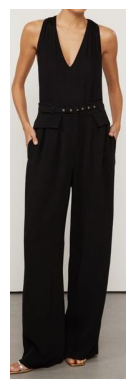

Green color clothing 1.00
White color clothing 0.97
Black color clothing 0.88

animale_images_cropped/calca/calca_calca-duo-off-white_off-white_25-34-1598-0003.jpg


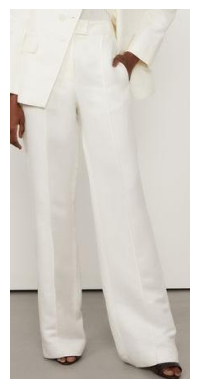

White color clothing 1.00
Black color clothing 0.98
Green color clothing 0.94

animale_images_cropped/blusa/top-blusa_blusa-de-tricot-com-manga-longa-e-gola-alta-slim-preto_preto_52-13-5233-0005.jpg


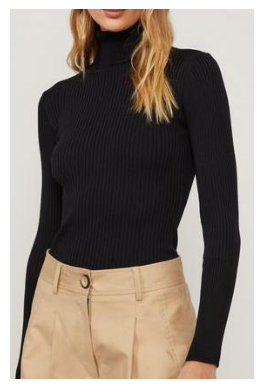

Green color clothing 0.98
White color clothing 0.89
Brown color clothing 0.87

animale_images_cropped/vestido/vestido_vestido-de-couro-curto-decote-quadrado_preto_07-20-5856-0005.jpg


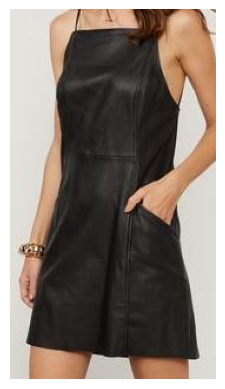

Blue color clothing 0.97
Black color clothing 0.86
White color clothing 0.70

animale_images_cropped/blusa/camisa_camisa-manga-longa-de-sarja-off-white_off-white_52-05-1629-0003.jpg


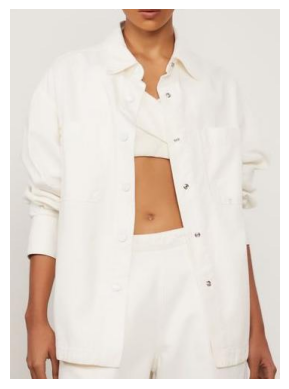

White color clothing 1.00
Green color clothing 0.97
Black color clothing 0.95

animale_images_cropped/saia/saia_saia-midi-com-franzido_preto_25-11-1402-0005.jpg


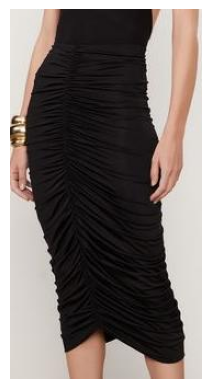

Blue color clothing 1.00
Black color clothing 0.95
White color clothing 0.84

animale_images_cropped/blusa/top-blusa_regata-de-tricot-roxo-com-lurex-long_roxo-mirtilo_52-15-1381-09252.jpg


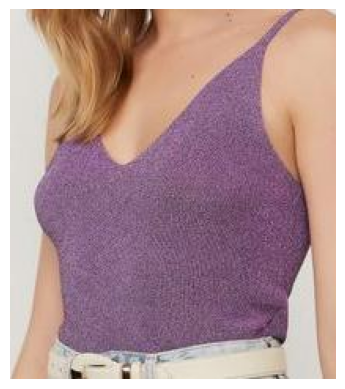

Pink color clothing 0.98
Purple color clothing 0.98
Red color clothing 0.56

animale_images_cropped/blusa/camisa_camisa-de-seda-ampla-preta-manga-longa_preto_52-05-1568-0005.jpg


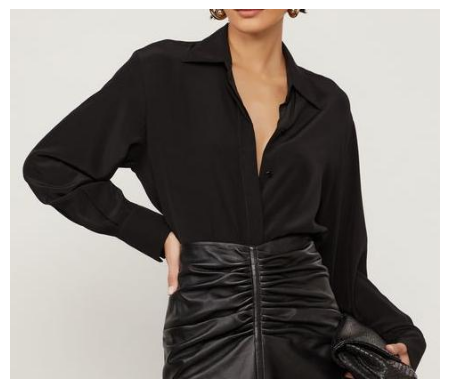

Black color clothing 0.99
Blue color clothing 0.99
White color clothing 0.93

animale_images_cropped/short/short_short-de-sarja-com-detalhe-barra-verde_verde-musgo_25-05-4206-04526.jpg


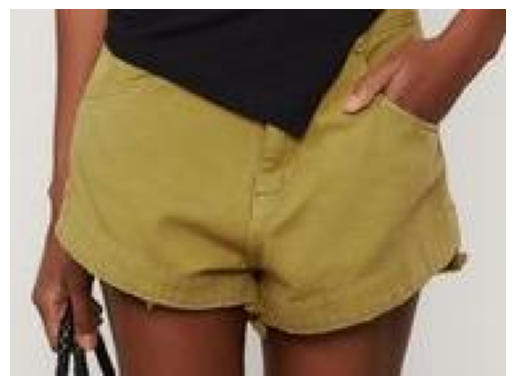

Yellow color clothing 0.99
Brown color clothing 0.87
Orange color clothing 0.73

animale_images_cropped/blazer/blazer_blazer-alongado-marrom-nozes-sem-lapela_marrom-nozes_03-04-0478-6048.jpg


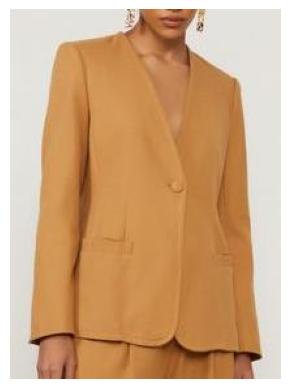

Orange color clothing 1.00
Yellow color clothing 0.82
Red color clothing 0.68



In [84]:
# Embeddings com pca para cores
cores_embeddings_pca = pca.transform(cores_embeddings)

# Aplicando o mesmo PCA nos embs das imagens
img_embeddings_pca = pca.transform(img_embs)

# Pegando 10 imagens aleatórias
sample_indexes = random.sample(range(img_embeddings_pca.shape[0]), 10)
img_embeddings_pca_sample = img_embeddings_pca[sample_indexes]
files = df['file_path'].values[sample_indexes]

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca_sample.shape[1]):
  min_value_color = cores_embeddings_pca[:, i].min()
  max_value_color = cores_embeddings_pca[:, i].max()
  min_value_img = img_embeddings_pca_sample[:, i].min()
  max_value_img = img_embeddings_pca_sample[:, i].max()
  img_embeddings_pca_sample[:, i] = (img_embeddings_pca_sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


cos_sim = util.cos_sim(img_embeddings_pca_sample, cores_embeddings_pca)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)
  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(description_list[top_3_indices[-i-1]], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

### Visualizando as duas primeiras dimensões do PCA

In [85]:
img_embeddings_pca.shape

(766, 2)

In [86]:
# Adicionando img_embeddings_pca ao df
pca_cols = [f'pca_{i}' for i in range(img_embeddings_pca.shape[1])]
print(pca_cols)
df[pca_cols] = img_embeddings_pca
print(f"df.shape: {df.shape}")
df.head(1)

['pca_0', 'pca_1']
df.shape: (766, 26)


,file_path,id_produto,grupo_produto,file_name,link,PRODUTOS,CARACTERISTICAS,LOCALIZACAO_ESTAMPA,COR_PREDOMINANTE,DECOTE_OU_GOLA,...,TIPO_CINTURA,COMPRIMENTO,MODELAGEM,ESTAMPA,FENDA_PERNA,MODELAGEM_SAIA,TIPO_BARRA,desc_produto,pca_0,pca_1
0,animale_images_cropped/blazer/blazer_blazer-al...,03-04-0464-0030,blazer,blazer_blazer-alfaiataria-est-onca-jacquard_be...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0464-0030,{COMPRIMENTO: MEDIO;MODELAGEM: AJUSTADA;COMPRI...,ROUPA_INTEIRA,BEGE,None,...,None,MEDIO,AJUSTADA,ANIMALPRINT_ONCA,None,None,None,blazer alfaiataria est onca jacquard,-0.96027,-0.387323


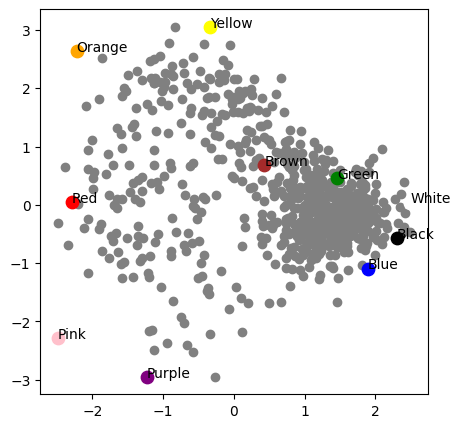

In [89]:
# Plot com as dimensões do PCA(X a dimensão 0, Y a dimensão 1) -usando apenas as duas primeiras dimensões de cores_embeddings_pca
plt.figure(figsize=(5, 5))

# Plotando alguns exemplos de imagens nesse plot de cores
sample = img_embeddings_pca

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(sample.shape[1]):
  min_value_color = cores_embeddings_pca[:, i].min()
  max_value_color = cores_embeddings_pca[:, i].max()
  min_value_img = sample[:, i].min()
  max_value_img = sample[:, i].max()
  sample[:, i] = (sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


for i, (x, y) in enumerate(sample[:, :2]):
    plt.scatter(x, y, color='gray')

for i, (x, y) in enumerate(cores_embeddings_pca[:, :2]):
    color = description_list[i].replace(" color clothing", "").replace("Roupa da cor ", "")
    # plotting colored according to the color value
    plt.scatter(x, y, color=color, s=80)
    plt.text(x, y, color)


### Testando em 3d

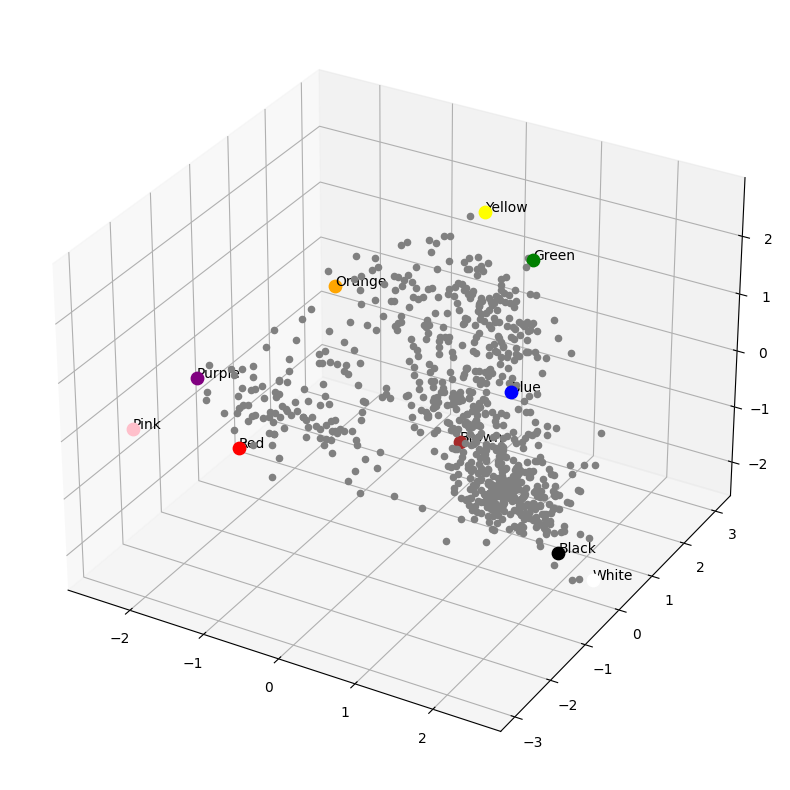

In [91]:
# Refazendo PCA com 3 dimensões
pca = PCA(n_components=3)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
img_embeddings_pca = pca.transform(img_embs)

sample = img_embeddings_pca

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(sample.shape[1]):
  min_value_color = cores_embeddings_pca[:, i].min()
  max_value_color = cores_embeddings_pca[:, i].max()
  min_value_img = sample[:, i].min()
  max_value_img = sample[:, i].max()
  sample[:, i] = (sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color

cos_sim = util.cos_sim(sample, cores_embeddings_pca)

# Plot 3d com as dimensões do PCA(X a dimensão 0, Y a dimensão 1, Z a dimensão 2) -usando as três primeiras dimensões de cores_embeddings_pca

from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

for i, (x, y, z) in enumerate(sample[:, :3]):
    ax.scatter(x, y, z, color='gray')

for i, (x, y, z) in enumerate(cores_embeddings_pca[:, :3]):
    color = description_list[i].replace(" color clothing", "").replace("Roupa da cor ", "")
    # plotting colored according to the color value
    ax.scatter(x, y, z, color=color, s=80)
    ax.text(x, y, z, color)


animale_images_cropped/blusa/top-blusa_top-de-couro-franzido-amarracao_preto_52-10-5260-0005.jpg


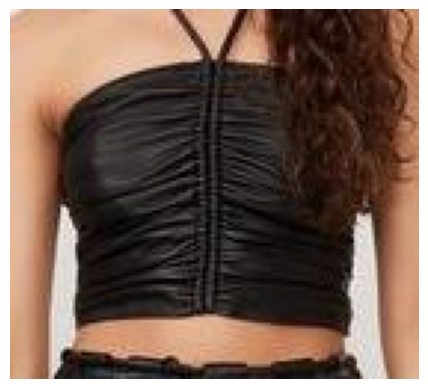

Black color clothing 0.90
White color clothing 0.77
Blue color clothing 0.56

animale_images_cropped/blusa/top-blusa_blusa-tricot-oversized-com-transparencia_verde-cha_52-13-5324-04356.jpg


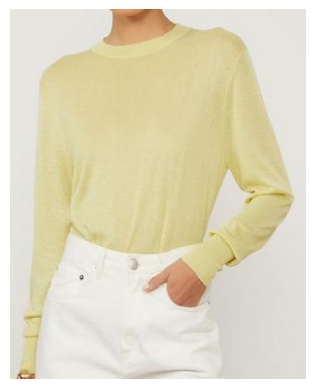

Yellow color clothing 0.90
Green color clothing 0.81
Orange color clothing 0.35

animale_images_cropped/saia/saia_saia-drapeada-de-seda-azul-hortensia_azul-hortensia_25-34-1619-04501.jpg


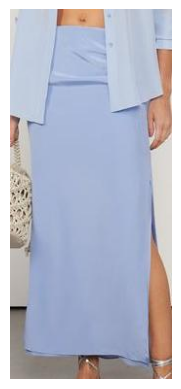

Purple color clothing 0.82
Blue color clothing 0.79
Green color clothing 0.42

animale_images_cropped/blusa/top-blusa_regata-de-tricot-vermelha-com-gola-u-canelado_vermelho-fiery_52-15-1370-8259.jpg


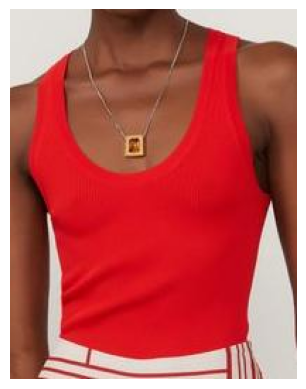

Orange color clothing 0.95
Red color clothing 0.79
Yellow color clothing 0.45

animale_images_cropped/vestido/vestido_vestido-de-malha-crepe-midi-marrom-ombro-a-ombro-cruzado_marrom-nozes_07-20-6613-6048.jpg


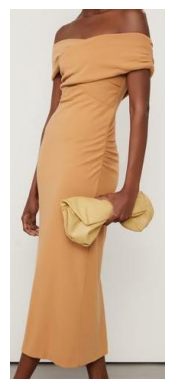

Yellow color clothing 0.98
Orange color clothing 0.83
Green color clothing 0.33

animale_images_cropped/blusa/top-blusa_top-de-tricot-faixa-cruzado-basic_preto_52-10-5210-0005.jpg


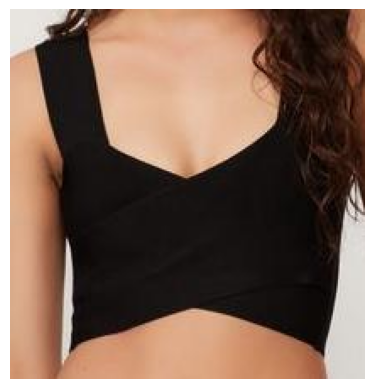

Black color clothing 0.87
White color clothing 0.77
Blue color clothing 0.38

animale_images_cropped/saia/saia_saia-midi-bordada-garden_bege-whitecap_25-11-1190-04346.jpg


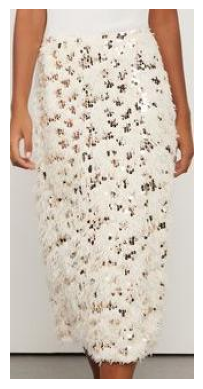

Black color clothing 0.82
White color clothing 0.77
Brown color clothing 0.40

animale_images_cropped/vestido/vestido_vestido-de-algodao-midi_bege-flan_07-20-6736-09276.jpg


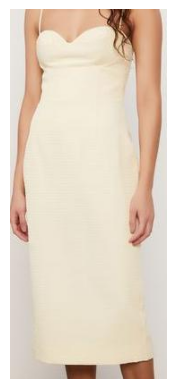

Black color clothing 0.99
White color clothing 0.96
Brown color clothing 0.61

animale_images_cropped/blusa/camisa_camisa-de-tricoline-essencial-branca_branco_52-05-1585-0002.jpg


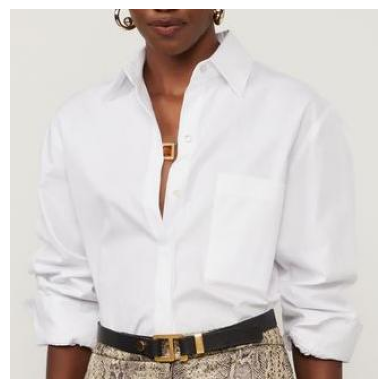

Black color clothing 0.99
White color clothing 0.97
Brown color clothing 0.64

animale_images_cropped/blazer/blazer_blazer-de-couro-acinturado-botoes-organicos_bege-whitecap_03-01-1628-04346.jpg


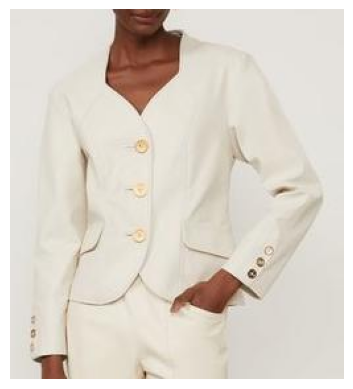

Black color clothing 0.97
White color clothing 0.88
Blue color clothing 0.55



In [97]:
sample_indexes = random.sample(range(sample.shape[0]), 10)
img_embeddings_pca_sample = img_embeddings_pca[sample_indexes]
files = df['file_path'].values[sample_indexes]

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca_sample.shape[1]):
  min_value_color = cores_embeddings_pca[:, i].min()
  max_value_color = cores_embeddings_pca[:, i].max()
  min_value_img = img_embeddings_pca_sample[:, i].min()
  max_value_img = img_embeddings_pca_sample[:, i].max()
  img_embeddings_pca_sample[:, i] = (img_embeddings_pca_sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


cos_sim = util.cos_sim(img_embeddings_pca_sample, cores_embeddings_pca)

# Vendo top 3 cores mais próximas para um sample de imagens
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)
  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(description_list[top_3_indices[-i-1]], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

Insights:

- O modelo entende melhor algumas cores em inglês, como o purple (não identificou como roxo).
- O modelo não está compreendendo a cor preta
- Branco e preto estão muito próximos, talvez porque a descrição foi textual? (se usarmos imagens será que melhora?)
- Precisamos de um jeito de recortar o grupo da roupa que queremos analisar (Olhar só pra calça, por exemplo)

### Imagens personalizadas: bloco de cores

In [264]:
import os

# Agora, vamos gerar os embeddings das imagens das cores (color_images)
pasta = "color_images"

# Criando lista com as image_paths da pasta
image_paths = [os.path.join(pasta, path).replace('\\','/') for path in os.listdir(pasta)]

# Criando um df_color com os nomes das imagens
df_color = pd.DataFrame(image_paths, columns=["image_path"])
df_color["color_name"] = df_color["image_path"].apply(lambda x: x.split("/")[-1].split(".")[0])

In [265]:
# Criando colunas para os embeddings
emb_columns = [f"emb_img_{i}" for i in range(512)]

# Now we load and encode the images
def load_image(url_or_path):
    if url_or_path.startswith("http://") or url_or_path.startswith("https://"):
        return Image.open(requests.get(url_or_path, stream=True).raw)
    else:
        return Image.open(url_or_path)

file_names = df_color['image_path'].values
images = [load_image(img) for img in file_names]
img_embeddings = img_model.encode(images)

# Colocando os embeddings no df
emb_dict = {}
for i, emb in enumerate(img_embeddings):
    emb_id = df_color.iloc[i]["color_name"]
    emb_dict[emb_id] = emb

df_color_embs = pd.DataFrame(emb_dict).T

df_color_embs.columns = emb_columns
df_color_embs["color_name"] = df_color_embs.index

df_color_embs = df_color_embs.reset_index(drop=True)[["color_name"] + emb_columns]

In [266]:
df_color_embs

,color_name,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
0,COR AMARELO,-0.028546,-0.025496,-0.417673,-0.056401,-0.140226,-0.443518,-0.168441,1.078504,-0.078835,...,0.232356,0.274418,0.405922,-0.071532,-0.292983,0.232331,-0.101903,0.777710,0.010010,-0.121242
1,COR AZUL,0.006238,-0.045781,-0.431332,-0.097486,-0.076914,-0.385147,-0.291344,1.304192,0.383190,...,0.180391,0.044304,0.326409,-0.031872,-0.116065,0.203804,-0.297466,0.716893,-0.139596,-0.128783
2,COR BRANCO,-0.073344,-0.132770,0.253046,-0.082826,0.171033,-0.083862,-0.289973,1.193479,-0.287285,...,0.279241,-0.072687,0.708488,-0.181231,-0.050427,-0.001854,-0.256473,0.840973,-0.169232,-0.228157
3,COR LARANJA,-0.082441,-0.087324,-0.115958,-0.285204,-0.273470,-0.187084,-0.188147,1.037961,0.035577,...,0.334134,0.222016,0.296361,0.105041,-0.340744,0.146224,-0.089053,0.782470,-0.034351,-0.270654
4,COR MARROM,0.129687,-0.148728,-0.106386,-0.164460,0.040059,-0.307845,-0.089132,0.950700,-0.319955,...,0.173314,0.059059,0.779322,0.071892,-0.055109,0.132718,-0.255734,0.735227,-0.228709,-0.160291
5,COR PRETO,-0.150350,-0.263389,-0.565511,-0.072226,0.155786,-0.043085,-0.387121,1.272081,0.283594,...,-0.079255,0.158420,0.648814,0.091011,-0.028377,-0.349301,-0.134815,0.772287,-0.364340,-0.293392
6,COR ROSA,-0.232607,-0.244402,-0.232435,-0.443345,-0.170635,-0.438234,-0.085661,1.015443,0.581087,...,0.050129,-0.196673,0.175514,-0.057394,0.017285,0.326810,-0.417590,0.759208,-0.005309,0.089440
7,COR ROXO,-0.040682,-0.236614,-0.166357,-0.177385,-0.007183,-0.484710,-0.252690,0.917476,0.151761,...,0.206618,0.219410,0.186061,-0.069840,-0.291403,0.162623,-0.207237,0.765841,-0.102973,0.039640
8,COR VERDE,0.041701,-0.172500,-0.322558,-0.331832,-0.085318,-0.456009,-0.269159,1.154621,-0.010214,...,0.428415,0.234530,0.443848,-0.184218,-0.117773,-0.014541,-0.146755,0.745211,-0.273161,-0.027780
9,COR VERMELHO,0.002639,-0.210456,-0.319800,-0.206563,-0.054426,-0.474577,-0.110277,1.187309,0.389176,...,0.233479,0.212013,0.133250,-0.031382,-0.130833,0.189375,-0.217279,0.767863,-0.050193,-0.035196


In [267]:
# Pegando só as colunas de embeddings de df_color_embs
color_img_cols = [col for col in df_color_embs.columns if 'emb_img_' in col]
cores_embeddings = df_color_embs[color_img_cols].values

# Usar PCA nos embs das cores
pca = PCA(n_components=2)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
img_embeddings_pca = pca.transform(img_embs)
cores_embeddings_pca.shape

(10, 2)

In [268]:
df_img_embs

,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,EMB_PCA_0,EMB_PCA_1,EMB_PCA_2,EMB_PCA_3,EMB_PCA_4,EMB_PCA_5,EMB_PCA_6,EMB_PCA_7,EMB_PCA_8,EMB_PCA_9
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,-0.960270,-0.387325,0.258111,0.293143,-0.486409,-0.494619,1.269619,0.510119,0.800549,-0.160035
1,03-04-0478-6048,-0.054035,0.210889,0.121748,0.122241,-0.188613,0.181957,-0.546432,-0.593038,0.491988,...,-1.062174,0.377862,0.881455,0.437405,-0.725173,-0.344233,1.415257,-0.319753,0.465910,-0.147162
2,03-04-0460-0003,-0.055339,0.376676,0.194497,0.267525,-0.240985,0.248852,-0.274237,-0.295000,0.566380,...,0.116691,-0.538572,0.055928,1.593126,-0.093513,-0.028782,1.053784,-0.187982,-0.109342,-0.344015
3,03-04-0461-0005,-0.039712,0.253769,0.223714,0.024840,-0.001702,0.225233,-0.487728,0.329303,0.675198,...,0.174865,-0.698840,0.483474,-0.369517,-0.642461,-0.282192,0.724731,-0.381273,0.196372,0.045344
4,03-04-0479-0024,-0.108800,0.091291,0.057245,0.337540,0.081135,-0.222907,-0.204011,0.349029,0.904539,...,0.007266,-0.624863,-0.125665,1.132339,-0.218630,-0.122677,1.302162,-0.081400,-0.200786,-0.295679
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
761,07-20-6778-0005,0.019623,0.102202,-0.036990,0.455425,-0.337472,0.351344,-0.092960,0.389567,0.625612,...,-0.060697,-0.706594,0.069555,-0.495000,-0.686084,-0.633242,0.687566,-0.510474,-0.059040,-0.020893
762,07-20-6402-09248,0.100392,-0.032767,-0.091637,0.404944,-0.598882,0.194458,-0.408226,-0.579717,0.427830,...,-1.084459,0.618621,0.902232,0.594793,-0.991361,-0.271020,1.212310,-0.626667,-0.118494,-0.287442
763,07-20-6401-0005,0.166221,-0.189078,-0.312695,0.481503,-0.309427,0.435620,-0.162573,0.445066,0.260107,...,-0.114086,-0.865194,0.271884,-0.211540,-0.669391,-0.381607,0.797741,-0.491213,-0.242632,0.143096
764,07-20-6659-09538,0.167080,-0.391681,-0.015006,0.289606,-0.200403,0.050729,-0.315043,-1.028018,0.580867,...,-0.313056,-0.323842,0.625165,-0.232851,-0.610340,-0.401192,1.408672,0.561081,0.527436,-0.365773


In [269]:
# Pegando as colunas de embeddings de df_img_embs
img_cols = [col for col in df_img_embs.columns if 'emb_img_' in col]
img_embs = df_img_embs[img_cols].values

In [270]:
img_embs.shape

(766, 512)

animale_images_cropped/blusa/top-blusa_blusa-de-malha-canelada-verde-com-manga-media_verde-folha_52-06-0688-09258.jpg


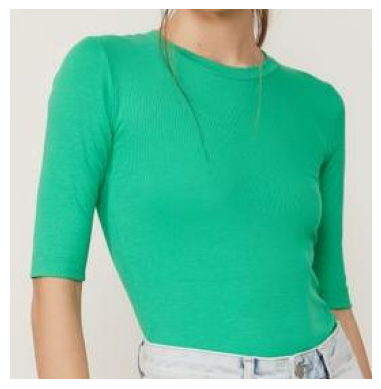

COR ROXO 1.00
COR LARANJA 0.95
COR ROSA 0.95

animale_images_cropped/calca/calca_calca-de-sarja-ampla-recorte-na-lateral_bege-whitecap_25-34-1826-0030.jpg


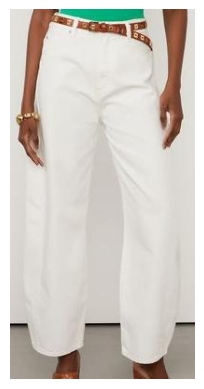

COR AMARELO 1.00
COR MARROM 0.92
COR LARANJA 0.64

animale_images_cropped/blusa/camisa_camisa-de-tricoline-listrada-verde-cage_verde-gage_03-06-0340-09254.jpg


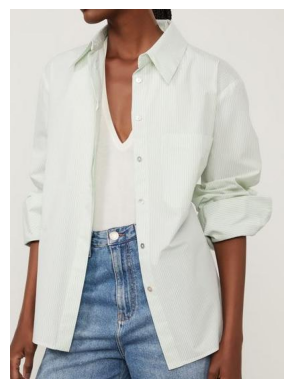

COR VERMELHO 0.95
COR VERDE 0.94
COR ROSA 0.81

animale_images_cropped/vestido/vestido_vestido-de-georgette-leve-manga-longa-camada-estampado_est-onca-nite-strawberry-p_07-20-6699-09744.jpg


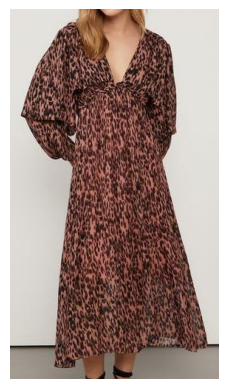

COR VERMELHO 0.84
COR VERDE 0.82
COR ROSA 0.64

animale_images_cropped/saia/saia_saia-longa-de-algodao-correntes_marrom-nozes_25-11-1250-6048.jpg


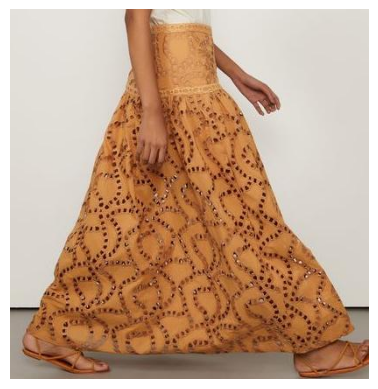

COR AMARELO 0.99
COR MARROM 0.87
COR LARANJA 0.72

animale_images_cropped/blazer/blazer_colete-bege-gergelim_bege-gergelim_03-06-0331-09247.jpg


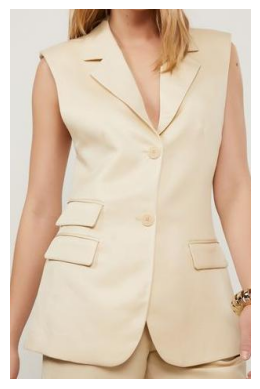

COR MARROM 0.97
COR BRANCO 0.82
COR AMARELO 0.80

animale_images_cropped/calca/calca_calca-de-malha-preta-com-pala-larga-e-fivela_preto_25-34-1754-0005.jpg


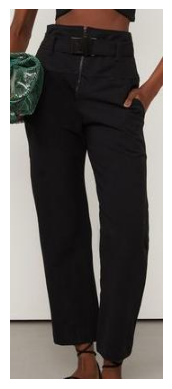

COR PRETO 1.00
COR AZUL 0.98
COR BRANCO 0.26

animale_images_cropped/vestido/vestido_vestido-midi-de-georgette-leve-manga-longa-barra-assimetrica-estampado_est-listra-spirulina-color_07-20-6597-09556.jpg


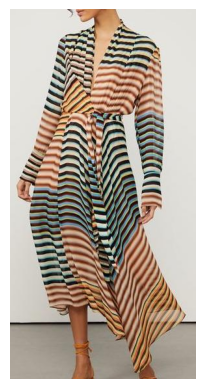

COR VERMELHO 0.81
COR VERDE 0.80
COR ROSA 0.61

animale_images_cropped/calca/calca_calca-de-couro-cintura-alta-passante-diagonal_bege-manha_25-34-1443-09041.jpg


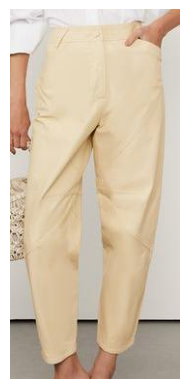

COR MARROM 1.00
COR AMARELO 0.91
COR BRANCO 0.68

animale_images_cropped/blusa/top-blusa_regata-de-malha-rib-laranja-com-decote-nadador_laranja-vibrante_52-15-1408-09249.jpg


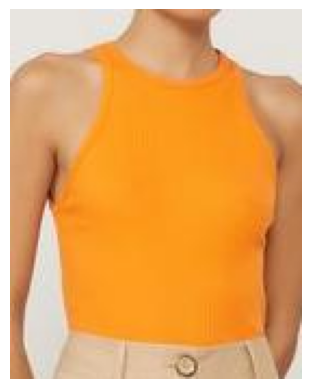

COR ROXO 0.99
COR LARANJA 0.97
COR ROSA 0.93



In [271]:
sample_indexes = random.sample(range(img_embs.shape[0]), 10)
img_embeddings_pca_sample = img_embeddings_pca[sample_indexes]
files = df['file_path'].values[sample_indexes]

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca_sample.shape[1]):
  min_value_color = cores_embeddings_pca[:, i].min()
  max_value_color = cores_embeddings_pca[:, i].max()
  min_value_img = img_embeddings_pca_sample[:, i].min()
  max_value_img = img_embeddings_pca_sample[:, i].max()
  img_embeddings_pca_sample[:, i] = (img_embeddings_pca_sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


cos_sim = util.cos_sim(img_embeddings_pca_sample, cores_embeddings_pca)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)
  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(df_color.iloc[top_3_indices[-i-1]]['color_name'], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

In [272]:
import plotly.graph_objs as go

# refazendo PCA com 3 dimensões
pca = PCA(n_components=3)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
img_embeddings_pca = pca.transform(img_embs)

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca.shape[1]):
    min_value_color = cores_embeddings_pca[:, i].min()
    max_value_color = cores_embeddings_pca[:, i].max()
    min_value_img = img_embeddings_pca[:, i].min()
    max_value_img = img_embeddings_pca[:, i].max()
    img_embeddings_pca[:, i] = (img_embeddings_pca[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color

color_dict = { # dicionario para obter as cores em ingles para pintar corretamente o grafico
    "AMARELO": "yellow",
    "AZUL": "blue",
    "BRANCO": "white",
    "LARANJA": "orange",
    "MARROM": "brown",
    "PRETO": "black",
    "ROSA": "pink",
    "ROXO": "purple",
    "VERDE": "green",
    "VERMELHO": "red"
}

# Plotly figure
fig = go.Figure()

# Adding gray image points with hover to show the actual image
for i in range(img_embeddings_pca.shape[0]):
    img_description = df.iloc[i]['desc_produto']
    fig.add_trace(go.Scatter3d(
        x=[img_embeddings_pca[i, 0]],
        y=[img_embeddings_pca[i, 1]],
        z=[img_embeddings_pca[i, 2]],
        mode='markers',
        marker=dict(size=5, color='gray'),
        name=f'Image {i}',
        text=img_description,
        hoverinfo='text'
    ))

# Adding color points
for i in range(cores_embeddings_pca.shape[0]):
    color = df_color.iloc[i]['color_name'].split(" ")[1]
    color = color_dict[color]
    fig.add_trace(go.Scatter3d(
        x=[cores_embeddings_pca[i, 0]],
        y=[cores_embeddings_pca[i, 1]],
        z=[cores_embeddings_pca[i, 2]],
        mode='markers+text',
        marker=dict(size=8, color=color),
        name=f'Color {color}',
        text=color,
        hoverinfo='text'
    ))

# Update layout for better visualization
fig.update_layout(
    title="3D PCA Embeddings of Images and Colors",
    scene=dict(
        xaxis_title="PCA Dimension 1",
        yaxis_title="PCA Dimension 2",
        zaxis_title="PCA Dimension 3"
    ),
    showlegend=False
)

# Show the plot
fig.show()


In [275]:
# Adicionando img_embeddings_pca ao df
pca_cols = [f'EMB_PCA_{i}' for i in range(img_embeddings_pca.shape[1])]
print(pca_cols)
df_img_embs[pca_cols] = img_embeddings_pca
print(f"df.shape: {df_img_embs.shape}")
df_img_embs.head(1)

['EMB_PCA_0', 'EMB_PCA_1', 'EMB_PCA_2']
df.shape: (766, 524)


,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,EMB_PCA_0,EMB_PCA_1,EMB_PCA_2,EMB_PCA_3,EMB_PCA_4,EMB_PCA_5,EMB_PCA_6,EMB_PCA_7,EMB_PCA_8,EMB_PCA_9
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,0.324734,1.389504,0.49232,0.293143,-0.486409,-0.494619,1.269619,0.510119,0.800549,-0.160035


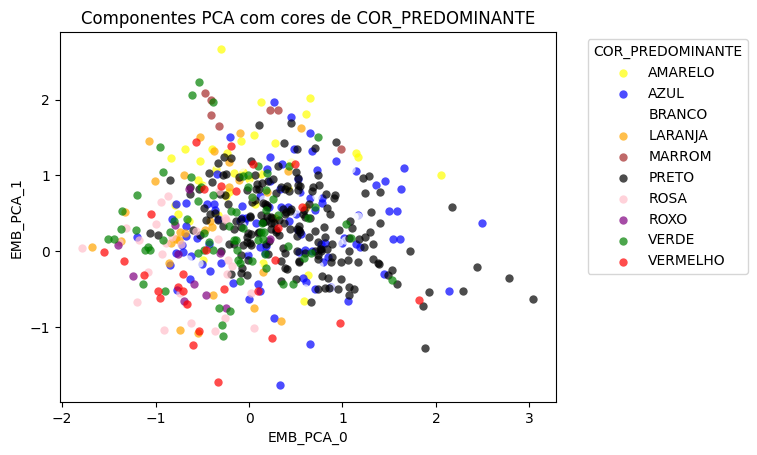

In [276]:
plot_cores(df_img_embs, cor_column='COR_PREDOMINANTE', reducer='PCA', color_dict=color_dict)

Insights:

- Mesmo com a padronização, as cores ainda estão muito próximas no espaço. É desejável transformar o espaço das cores base para distribuí-las mais uniformemente. 

- Uma alternativa, como mencionado anteriormente, seria realizar um finetunning com as imagens das roupas coloridas para seja possível compreender melhor as cores e clusterizar os produtos (tarefa não trivial)

## Visualizando espaços com dimensões maiores

Podemos utilizar o t-SNE para visualizar o espaço em dimensões maiores e tentar identificar padrões de agrupamento.

In [260]:
# Função que aplica t-SNE para reduzir para duas dimensões
from sklearn.manifold import TSNE
from umap.umap_ import UMAP

def apply_tsne(df, colunas, n_components=2, tsne=None):

    if tsne is None:
        # Removendo linhas com valores nulos para treinar o modelo

        # Inicializando o modelo t-SNE
        tsne = TSNE(n_components=n_components, random_state=42)

        # Treinando o modelo e transformando os dados
        componentes = tsne.fit_transform(df[colunas])

        # Criando um novo DataFrame com as colunas desejadas
        df_tsne = df[['id_produto', 'COR_PREDOMINANTE']].copy() 
    else:
        # Transformando os dados
        componentes = tsne.transform(df[colunas])

        # Criando um novo DataFrame com as colunas desejadas
        df_tsne = df[['id_produto']].copy()

    for i in range(n_components):
        df_tsne[f'EMB_TSNE_{i}'] = componentes[:, i]

    return df_tsne, tsne

def apply_umap(df, colunas, n_components=2, umap=None):

    if umap is None:
        # Removendo linhas com valores nulos para treinar o modelo

        # Inicializando o modelo t-SNE
        umap = UMAP(n_components=n_components, random_state=42)

        # Treinando o modelo e transformando os dados
        componentes = umap.fit_transform(df[colunas])

        # Criando um novo DataFrame com as colunas desejadas
        df_umap = df[['id_produto', 'COR_PREDOMINANTE']].copy() 
    else:
        # Transformando os dados
        componentes = umap.transform(df[colunas])

        # Criando um novo DataFrame com as colunas desejadas
        df_umap = df[['id_produto']].copy()

    for i in range(n_components):
        df_umap[f'EMB_UMAP_{i}'] = componentes[:, i]

    return df_umap, umap

In [288]:
# Lendo img_embeddings.parquet e text_embeddings.parquet
df_img_embs = pd.read_parquet('datasets/img_embeddings.parquet')
df_text_embs = pd.read_parquet('datasets/text_embeddings.parquet')

In [289]:
df_img_embs

,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,-0.028948,-0.075428,0.560166,-0.266601,-0.213009,0.003456,0.251050,0.798051,-0.282096,0.032521
1,03-04-0478-6048,-0.054035,0.210889,0.121748,0.122241,-0.188613,0.181957,-0.546432,-0.593038,0.491988,...,-0.078863,-0.138086,0.505052,-0.106603,-0.323217,0.086038,0.390587,0.986789,-0.125528,0.456620
2,03-04-0460-0003,-0.055339,0.376676,0.194497,0.267525,-0.240985,0.248852,-0.274237,-0.295000,0.566380,...,-0.101799,0.288448,0.961003,-0.158184,-0.075985,-0.393318,0.039428,0.660712,-0.019683,-0.080595
3,03-04-0461-0005,-0.039712,0.253769,0.223714,0.024840,-0.001702,0.225233,-0.487728,0.329303,0.675198,...,-0.054398,-0.092576,0.788266,-0.300475,-0.480824,0.114495,0.257658,0.308829,-0.102123,0.451775
4,03-04-0479-0024,-0.108800,0.091291,0.057245,0.337540,0.081135,-0.222907,-0.204011,0.349029,0.904539,...,0.211785,0.094541,0.865604,0.263496,-0.160512,-0.463765,0.182257,0.214232,-0.032568,-0.254120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
761,07-20-6778-0005,0.019623,0.102202,-0.036990,0.455425,-0.337472,0.351344,-0.092960,0.389567,0.625612,...,-0.169518,-0.099625,0.346413,-0.277054,0.040731,-0.580248,-0.106754,0.754394,-0.125312,0.119866
762,07-20-6402-09248,0.100392,-0.032767,-0.091637,0.404944,-0.598882,0.194458,-0.408226,-0.579717,0.427830,...,-0.130489,-0.199756,0.095518,0.122175,-0.062147,-0.073805,0.037836,0.989817,-0.157222,0.231829
763,07-20-6401-0005,0.166221,-0.189078,-0.312695,0.481503,-0.309427,0.435620,-0.162573,0.445066,0.260107,...,-0.256586,-0.288520,0.117256,0.030498,-0.306072,-0.199355,0.063874,0.299538,-0.106902,-0.006913
764,07-20-6659-09538,0.167080,-0.391681,-0.015006,0.289606,-0.200403,0.050729,-0.315043,-1.028018,0.580867,...,0.069929,-0.363056,0.518750,0.049510,-0.099344,-0.377340,0.139283,1.364434,-0.356402,0.571959


In [290]:
df_text_embs

,id_produto,emb_text_0,emb_text_1,emb_text_2,emb_text_3,emb_text_4,emb_text_5,emb_text_6,emb_text_7,emb_text_8,...,emb_text_502,emb_text_503,emb_text_504,emb_text_505,emb_text_506,emb_text_507,emb_text_508,emb_text_509,emb_text_510,emb_text_511
0,03-04-0464-0030,-0.140957,0.055848,0.060496,-0.009640,-0.006583,-0.019780,-0.037161,-0.674555,-0.107772,...,-0.127676,0.034118,-0.093353,-0.006078,-0.195263,0.089614,0.037703,0.032443,0.002578,-0.072540
1,03-04-0478-6048,0.022282,0.035855,-0.035656,-0.083811,0.133575,-0.020404,0.025135,-0.836065,-0.030868,...,-0.132474,0.253243,0.272666,-0.198823,-0.225515,0.043200,0.134832,0.118328,0.038592,-0.021070
2,03-04-0460-0003,-0.201423,-0.047509,0.111407,0.106363,0.001601,-0.091679,-0.049687,-1.021254,0.239953,...,-0.112423,0.164116,0.316658,-0.171634,-0.076972,0.133305,0.124074,0.104498,0.096328,-0.093695
3,03-04-0461-0005,0.056737,-0.098422,-0.025516,0.121098,0.159703,-0.130418,0.002501,-0.946231,0.236212,...,-0.114555,0.246058,0.222511,-0.149034,-0.232584,-0.007690,0.181305,0.097594,0.029011,0.191715
4,03-04-0479-0024,-0.152286,0.122383,-0.056513,0.053768,0.004230,0.082884,-0.036410,-0.833223,0.127271,...,-0.034650,0.267200,0.456682,-0.158716,-0.130084,0.021563,0.126538,0.164664,0.051230,-0.078354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
761,07-20-6778-0005,0.001728,-0.013817,-0.331297,-0.029529,0.039674,0.127965,0.143076,-0.631284,0.284759,...,-0.059171,0.152342,0.713068,0.009847,0.253586,0.054280,-0.172634,0.257872,0.015978,-0.013561
762,07-20-6402-09248,0.070189,0.078888,-0.239820,0.126847,-0.122715,0.013601,0.065861,-0.923679,0.047594,...,0.049847,0.301316,0.256057,-0.139695,0.227935,-0.001610,-0.018016,-0.070100,-0.077508,-0.062803
763,07-20-6401-0005,0.070189,0.078888,-0.239820,0.126847,-0.122715,0.013601,0.065861,-0.923679,0.047594,...,0.049847,0.301316,0.256057,-0.139695,0.227935,-0.001610,-0.018016,-0.070100,-0.077508,-0.062803
764,07-20-6659-09538,0.044184,-0.281669,0.043424,0.005081,-0.044634,-0.155663,-0.233487,-0.869300,0.066055,...,-0.125353,0.082047,0.112800,-0.076957,0.056874,0.013178,0.019247,0.180022,-0.100837,0.082138


In [471]:
# Lendo base_animale_categorizada.parquet
df = pd.read_parquet('datasets/base.parquet')

In [292]:
df

,file_path,id_produto,grupo_produto,file_name,link,PRODUTOS,CARACTERISTICAS,LOCALIZACAO_ESTAMPA,COR_PREDOMINANTE,DECOTE_OU_GOLA,...,ESTILO,TIPO_MANGA,TIPO_CINTURA,COMPRIMENTO,MODELAGEM,ESTAMPA,FENDA_PERNA,MODELAGEM_SAIA,TIPO_BARRA,desc_produto
0,animale_images_cropped/blazer/blazer_blazer-al...,03-04-0464-0030,blazer,blazer_blazer-alfaiataria-est-onca-jacquard_be...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0464-0030,{COMPRIMENTO: MEDIO;MODELAGEM: AJUSTADA;COMPRI...,ROUPA_INTEIRA,BEGE,None,...,CASUAL,REGULAR,None,MEDIO,AJUSTADA,ANIMALPRINT_ONCA,None,None,None,blazer alfaiataria est onca jacquard
1,animale_images_cropped/blazer/blazer_blazer-al...,03-04-0478-6048,blazer,blazer_blazer-alongado-marrom-nozes-sem-lapela...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0478-6048,{COMPRIMENTO: MEDIO;MODELAGEM: AJUSTADA;COMPRI...,N/A,BEGE,None,...,SOCIAL,REGULAR,None,MEDIO,AJUSTADA,SEM_ESTAMPA,None,None,None,blazer alongado marrom nozes sem lapela
2,animale_images_cropped/blazer/blazer_blazer-ci...,03-04-0460-0003,blazer,blazer_blazer-cinque-off-white_off-white_03-04...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0460-0003,{COMPRIMENTO: MEDIO;MODELAGEM: AJUSTADA;COMPRI...,N/A,BRANCO,None,...,SOCIAL,REGULAR,None,MEDIO,AJUSTADA,SEM_ESTAMPA,None,None,None,blazer cinque off white
3,animale_images_cropped/blazer/blazer_blazer-ci...,03-04-0461-0005,blazer,blazer_blazer-cinque-preto_preto_03-04-0461-00...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0461-0005,{COMPRIMENTO: MEDIO; MODELAGEM: AJUSTADA; COMP...,N/A,PRETO,None,...,SOCIAL,REGULAR,None,MEDIO,AJUSTADA,SEM_ESTAMPA,None,None,None,blazer cinque preto
4,animale_images_cropped/blazer/blazer_blazer-co...,03-04-0479-0024,blazer,blazer_blazer-com-transpasse-de-crepe-off-whit...,https://animaleproductsimages.s3.us-east-1.ama...,03-04-0479-0024,{COMPRIMENTO: MEDIO; MODELAGEM: AJUSTADA; COMP...,N/A,BRANCO,None,...,SOCIAL,REGULAR,None,MEDIO,AJUSTADA,SEM_ESTAMPA,None,None,None,blazer com transpasse de crepe off white
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
761,animale_images_cropped/vestido/vestido_vestido...,07-20-6778-0005,vestido,vestido_vestido-tricot-transparencia_preto_07-...,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6778-0005,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,N/A,PRETO,HALTER,...,CASUAL,N/A,None,None,None,SEM_ESTAMPA,SIM,REGULAR,None,vestido tricot transparencia
762,animale_images_cropped/vestido/vestido_vestido...,07-20-6402-09248,vestido,vestido_vestido-tube_laranja-aura_07-20-6402-0...,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6402-09248,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,N/A,LARANJA,REDONDA,...,BASICO,N/A,None,None,None,SEM_ESTAMPA,N/A,REGULAR,None,vestido tube
763,animale_images_cropped/vestido/vestido_vestido...,07-20-6401-0005,vestido,vestido_vestido-tube_preto_07-20-6401-0005.jpg,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6401-0005,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,N/A,PRETO,REDONDA,...,SOCIAL,N/A,None,None,None,SEM_ESTAMPA,N/A,REGULAR,None,vestido tube
764,animale_images_cropped/vestido/vestido_vestido...,07-20-6659-09538,vestido,vestido_vestido-tule-babados-lili-est-leopardo...,https://animaleproductsimages.s3.us-east-1.ama...,07-20-6659-09538,{COMPRIMENTO_SAIA: CALCANHAR;COMPRIMENTO_MANGA...,ROUPA_INTEIRA,BEGE,TOMARA_QUE_CAIA,...,FESTIVO,OMBRO_A_OMBRO,None,None,None,ANIMALPRINT_ONCA,N/A,EVASÊ,None,vestido tule babados lili est leopardo


### Incluindo classe de cor

In [293]:
# Merge entre as base para incluir COR_PREDOMINANTE em df_img_embs e df_text_embs
df_img_embs = df_img_embs.merge(df[['id_produto', 'COR_PREDOMINANTE']], on='id_produto')

df_text_embs = df_text_embs.merge(df[['id_produto', 'COR_PREDOMINANTE']], on='id_produto')

In [294]:
df_img_embs['COR_PREDOMINANTE'].value_counts()

PRETO            195
BEGE             111
AZUL              96
BRANCO            87
VERDE             73
AMARELO           36
LARANJA           32
ROSA              30
VERMELHO          29
OFF_WHITE         29
MULTICOLORIDO     13
ROXO              11
JEANS              8
MARROM             7
LILÁS              4
CINZA              3
VINHO              1
DOURADO            1
Name: COR_PREDOMINANTE, dtype: int64

### Plot df_img_embs

In [295]:
# Aplicando apply_tsne para visualização dos embeddings de df_img_embs

emb_cols_img = [col for col in df_img_embs.columns if 'emb_img_' in col]

df_img_tsne, tsne_img_model = apply_tsne(df_img_embs, emb_cols_img, n_components=2)

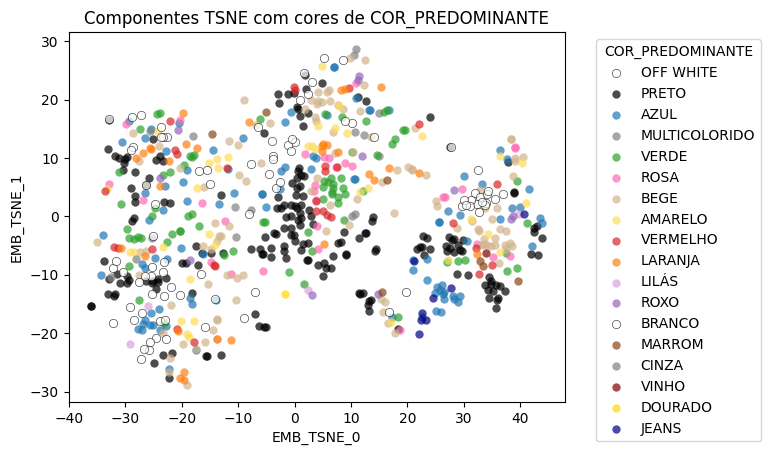

In [296]:
# Plot t-SNE usando plot_cores
plot_cores(df_img_tsne, cor_column='COR_PREDOMINANTE', reducer='TSNE', color_dict=color_dict)

### Refazendo PCA com mais dimensões e visualizando com t-SNE

#### DESCRIÇÕES PERSONALIZADAS

In [323]:
description_list

['Black color clothing',
 'White color clothing',
 'Red color clothing',
 'Yellow color clothing',
 'Green color clothing',
 'Blue color clothing',
 'Purple color clothing',
 'Brown color clothing',
 'Pink color clothing',
 'Orange color clothing']

In [324]:
cores_embeddings = text_model.encode(description_list)

In [325]:
img_embs = df_img_embs[emb_cols_img].values

In [326]:
# refazendo PCA com 10 dimensões
pca = PCA(n_components=10)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
img_embeddings_pca = pca.transform(img_embs)

In [327]:
# Adicionando img_embeddings_pca ao df
pca_cols = [f'EMB_PCA_{i}' for i in range(img_embeddings_pca.shape[1])]
print(pca_cols)
df_img_embs[pca_cols] = img_embeddings_pca
print(f"df.shape: {df_img_embs.shape}")
df_img_embs.head(1)

['EMB_PCA_0', 'EMB_PCA_1', 'EMB_PCA_2', 'EMB_PCA_3', 'EMB_PCA_4', 'EMB_PCA_5', 'EMB_PCA_6', 'EMB_PCA_7', 'EMB_PCA_8', 'EMB_PCA_9']
df.shape: (766, 524)


,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,EMB_PCA_0,EMB_PCA_1,EMB_PCA_2,EMB_PCA_3,EMB_PCA_4,EMB_PCA_5,EMB_PCA_6,EMB_PCA_7,EMB_PCA_8,EMB_PCA_9
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,-0.96027,-0.387325,0.258111,0.293143,-0.486409,-0.494619,1.269619,0.510119,0.800549,-0.160035


In [328]:
df_img_embs['COR_PREDOMINANTE'].value_counts()

PRETO            195
BEGE             111
AZUL              96
BRANCO            87
VERDE             73
AMARELO           36
LARANJA           32
ROSA              30
VERMELHO          29
OFF_WHITE         29
MULTICOLORIDO     13
ROXO              11
JEANS              8
MARROM             7
LILÁS              4
CINZA              3
VINHO              1
DOURADO            1
Name: COR_PREDOMINANTE, dtype: int64

In [303]:
# Aplicando apply_tsne para visualização dos embeddings de df_img_embs
df_img_pca_tsne, tsne_img_pca_model = apply_tsne(df_img_embs, pca_cols, n_components=2)

In [304]:
df_img_pca_tsne

,id_produto,COR_PREDOMINANTE,EMB_TSNE_0,EMB_TSNE_1
0,03-04-0464-0030,BEGE,-8.538465,-7.012208
1,03-04-0478-6048,BEGE,-13.539447,-14.723920
2,03-04-0460-0003,BRANCO,-24.408964,13.448093
3,03-04-0461-0005,PRETO,21.049515,3.127248
4,03-04-0479-0024,BRANCO,-20.419920,13.729863
...,...,...,...,...
761,07-20-6778-0005,PRETO,30.085987,-4.974079
762,07-20-6402-09248,LARANJA,-14.573983,-17.956810
763,07-20-6401-0005,PRETO,26.151300,-0.283697
764,07-20-6659-09538,BEGE,0.940817,-11.388315


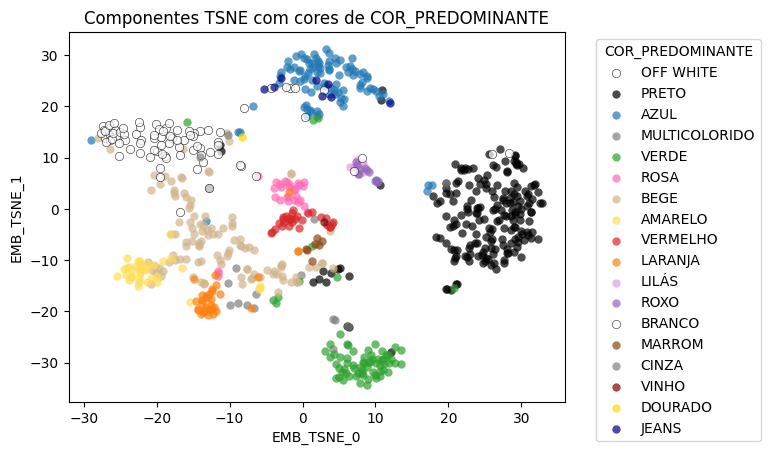

In [305]:
plot_cores(df_img_pca_tsne, cor_column='COR_PREDOMINANTE', reducer='TSNE', color_dict=color_dict)

In [306]:
# Aplicando apply_umap para visualização dos embeddings de df_img_embs
df_img_pca_umap, umap_img_pca_model = apply_umap(df_img_embs, pca_cols, n_components=2)

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



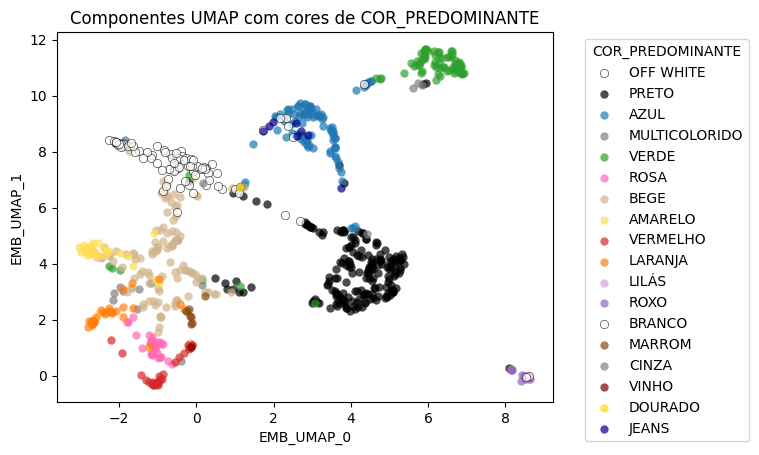

In [307]:
plot_cores(df_img_pca_umap, cor_column='COR_PREDOMINANTE', reducer='UMAP', color_dict=color_dict)

animale_images_cropped/blusa/top-blusa_blusa-de-tule-plissado-estampada-com-manga-longa_est-leopardo_52-13-5475-09538.jpg


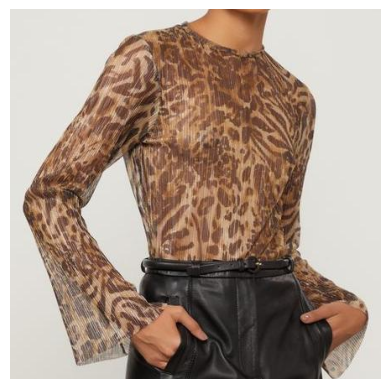

Brown color clothing 0.68
Black color clothing 0.60
Orange color clothing 0.17

animale_images_cropped/vestido/vestido_vestido-de-tricot-azul-com-fenda-profunda-e-decote-reto_azul-oceanico_07-20-6339-09245.jpg


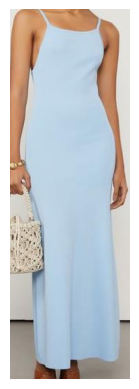

Blue color clothing 0.76
White color clothing 0.38
Yellow color clothing 0.17

animale_images_cropped/calca/calca_calca-cenoura-clochard-com-faixa-de-algodao-preta_preto_25-34-1917-0005.jpg


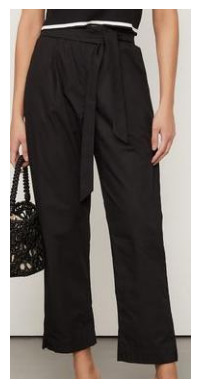

Black color clothing 0.90
White color clothing 0.27
Blue color clothing 0.08

animale_images_cropped/calca/calca_calca-de-tweed-perna-reta-listra-bicolor_marinho---preto_25-34-1715-1974.jpg


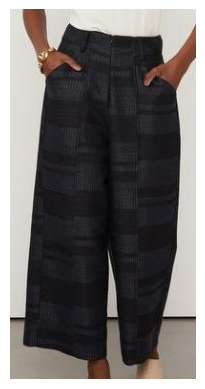

Black color clothing 0.70
Blue color clothing 0.60
Yellow color clothing 0.03

animale_images_cropped/vestido/vestido_vestido-gola-alta-manga-longa-floral_est-floral-cura-color-m_07-20-6413-09542.jpg


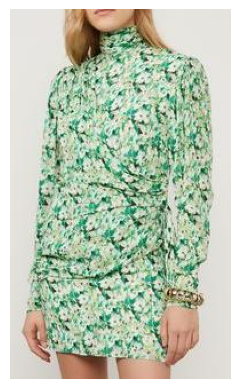

Green color clothing 0.83
Blue color clothing 0.22
White color clothing 0.17

animale_images_cropped/blazer/blazer_blazer-uno-bege-madeira_bege-madeira_03-04-0467-0800.jpg


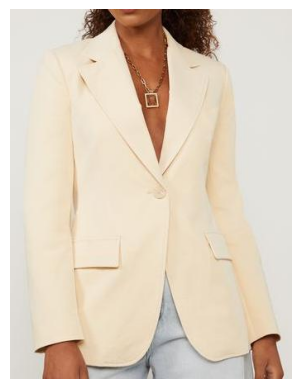

White color clothing 0.61
Yellow color clothing 0.36
Brown color clothing 0.28

animale_images_cropped/vestido/vestido_vestido-de-malha-curto-vermelho-um-ombro-so-manga-longa_vermelho-fiery_07-20-6553-8259.jpg


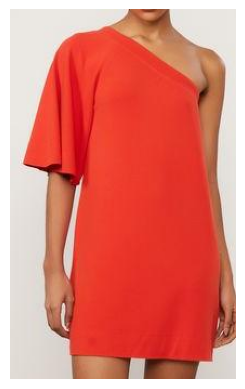

Orange color clothing 0.92
Red color clothing 0.44
Yellow color clothing 0.24

animale_images_cropped/calca/calca_calca-reta-com-elastico-no-cos-estampada_est-lenco-pois-recote-g_25-34-1640-09607.jpg


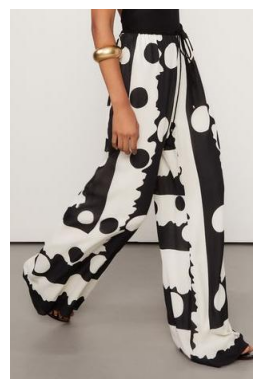

White color clothing 0.74
Black color clothing 0.67
Brown color clothing -0.00

animale_images_cropped/short/short_short-de-couro-debrum-asa-delta-marrom-bordo_marrom-bordo_25-05-4175-09281.jpg


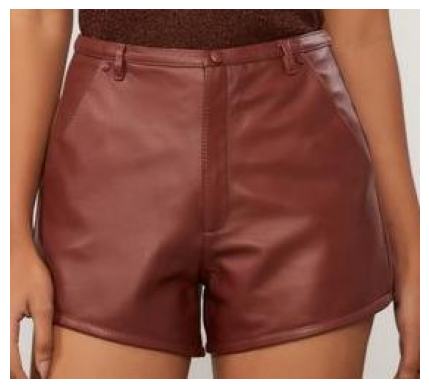

Brown color clothing 0.73
Red color clothing 0.31
Orange color clothing 0.22

animale_images_cropped/vestido/vestido_vestido-mini-de-jersey-com-decote-organi_verde-encanto_07-20-6441-09253.jpg


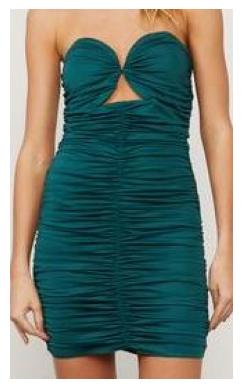

Green color clothing 0.86
Blue color clothing 0.41
Black color clothing 0.08

animale_images_cropped/vestido/vestido_vestido-de-malha-longo-estampado-com-detalhe-de-babado_est-pois-grafic-color_07-20-6594-09561.jpg


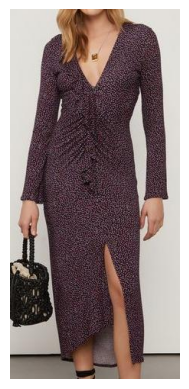

Purple color clothing 0.93
Pink color clothing 0.30
Black color clothing 0.13

animale_images_cropped/calca/calca_calca-jeans-boot-basic-high-dark-blue_jeans-escuro_25-34-1777-0109.jpg


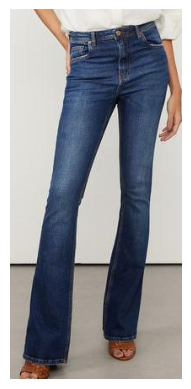

Blue color clothing 0.82
Yellow color clothing 0.32
Orange color clothing 0.06

animale_images_cropped/vestido/vestido_vestido-de-georgette-midi-franzido-frente-estampado_est-gravataria-flor-kirli-e-preto_07-20-6590-09656.jpg


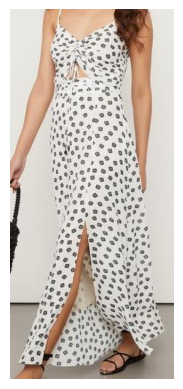

White color clothing 0.77
Yellow color clothing 0.29
Black color clothing 0.20

animale_images_cropped/vestido/vestido_vestido-de-malha-crepe-midi-alca-torcao_preto_07-20-6932-0005.jpg


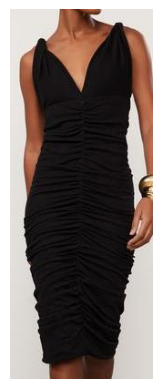

Black color clothing 0.95
Brown color clothing 0.17
Blue color clothing 0.05

animale_images_cropped/calca/calca_calca-amarracao-crepe_azul-print_25-34-1714-09246.jpg


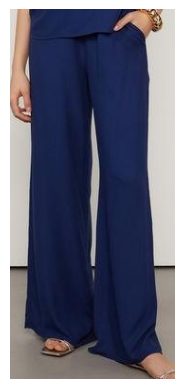

Blue color clothing 0.96
Purple color clothing 0.17
Green color clothing -0.01

animale_images_cropped/vestido/vestido_vestido-de-linho-curto-off-white-de-richelieu_off-white_07-20-5835-0003.jpg


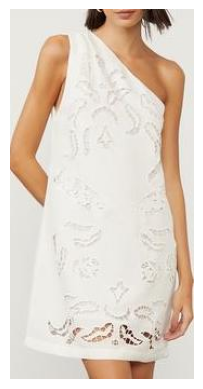

White color clothing 0.90
Yellow color clothing 0.10
Orange color clothing 0.07

animale_images_cropped/blusa/top-blusa_regata-de-malha-canelada-verde_verde-folha_52-15-1431-09258.jpg


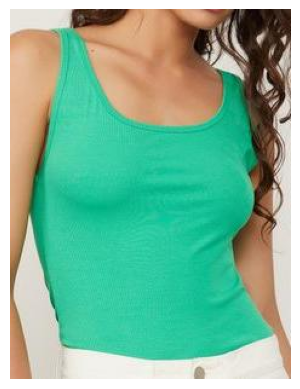

Green color clothing 0.89
Yellow color clothing 0.22
Orange color clothing 0.05

animale_images_cropped/calca/calca_calca-de-couro-com-cinto-barra-botoes-preto_preto_25-34-1734-0005.jpg


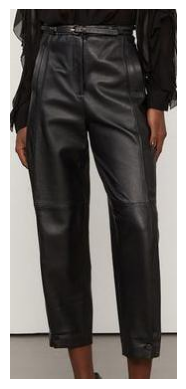

Black color clothing 0.90
Brown color clothing 0.35
Yellow color clothing 0.14

animale_images_cropped/blazer/blazer_blazer-de-crepe-off-white_off-white_03-04-0491-0003.jpg


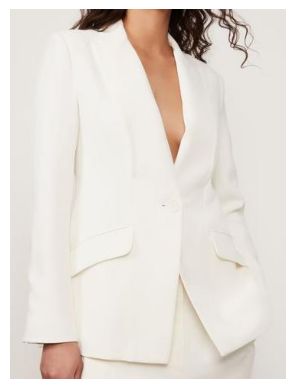

White color clothing 0.97
Yellow color clothing 0.06
Black color clothing 0.03

animale_images_cropped/blusa/camisa_camisa-cropped-polo-ampla-decote-v-estampada_est-geo-caminho_52-05-1541-09601.jpg


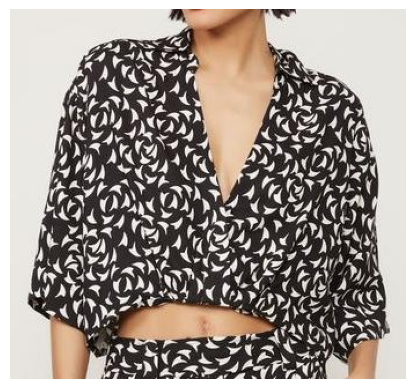

Black color clothing 0.75
White color clothing 0.38
Yellow color clothing 0.15



In [315]:
# Pegando 10 imagens aleatórias
sample_indexes = random.sample(range(img_embeddings_pca.shape[0]), 20)
img_embeddings_pca_sample = img_embeddings_pca[sample_indexes]
files = df['file_path'].values[sample_indexes]

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca_sample.shape[1]):
    min_value_color = cores_embeddings_pca[:, i].min()
    max_value_color = cores_embeddings_pca[:, i].max()
    min_value_img = img_embeddings_pca_sample[:, i].min()
    max_value_img = img_embeddings_pca_sample[:, i].max()
    img_embeddings_pca_sample[:, i] = (img_embeddings_pca_sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


cos_sim = util.cos_sim(img_embeddings_pca_sample, cores_embeddings_pca)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)

  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(description_list[top_3_indices[-i-1]], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

Muuuito melhor com 10 dimensões! Conseguimos ver uma separação mais clara das cores.

Ideia para resolver um possível problema: 
Incluir grupo do produto ao invés de cloting. Ex: black color top ao inves de black color clothing.

Um subespaço por grupo de produto?

#### IMAGENS PERSONALIZADAS

In [329]:
# Agora, vamos gerar os embeddings das imagens das cores (color_images)
pasta = "color_images"

# Criando lista com as image_paths da pasta
image_paths = [os.path.join(pasta, path).replace('\\','/') for path in os.listdir(pasta)]

# Criando um df_color com os nomes das imagens
df_color = pd.DataFrame(image_paths, columns=["image_path"])
df_color["color_name"] = df_color["image_path"].apply(lambda x: x.split("/")[-1].split(".")[0])

In [330]:
# Criando colunas para os embeddings
emb_columns = [f"emb_img_{i}" for i in range(512)]

# Now we load and encode the images
def load_image(url_or_path):
    if url_or_path.startswith("http://") or url_or_path.startswith("https://"):
        return Image.open(requests.get(url_or_path, stream=True).raw)
    else:
        return Image.open(url_or_path)

file_names = df_color['image_path'].values
images = [load_image(img) for img in file_names]
img_embeddings = img_model.encode(images)

# Colocando os embeddings no df
emb_dict = {}
for i, emb in enumerate(img_embeddings):
    emb_id = df_color.iloc[i]["color_name"]
    emb_dict[emb_id] = emb

df_color_embs = pd.DataFrame(emb_dict).T

df_color_embs.columns = emb_columns
df_color_embs["color_name"] = df_color_embs.index

df_color_embs = df_color_embs.reset_index(drop=True)[["color_name"] + emb_columns]

In [331]:
df_color_embs

,color_name,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
0,COR AMARELO,-0.028546,-0.025496,-0.417673,-0.056401,-0.140226,-0.443518,-0.168441,1.078504,-0.078835,...,0.232356,0.274418,0.405922,-0.071532,-0.292983,0.232331,-0.101903,0.777710,0.010010,-0.121242
1,COR AZUL,0.006238,-0.045781,-0.431332,-0.097486,-0.076914,-0.385147,-0.291344,1.304192,0.383190,...,0.180391,0.044304,0.326409,-0.031872,-0.116065,0.203804,-0.297466,0.716893,-0.139596,-0.128783
2,COR BRANCO,-0.073344,-0.132770,0.253046,-0.082826,0.171033,-0.083862,-0.289973,1.193479,-0.287285,...,0.279241,-0.072687,0.708488,-0.181231,-0.050427,-0.001854,-0.256473,0.840973,-0.169232,-0.228157
3,COR LARANJA,-0.082441,-0.087324,-0.115958,-0.285204,-0.273470,-0.187084,-0.188147,1.037961,0.035577,...,0.334134,0.222016,0.296361,0.105041,-0.340744,0.146224,-0.089053,0.782470,-0.034351,-0.270654
4,COR MARROM,0.129687,-0.148728,-0.106386,-0.164460,0.040059,-0.307845,-0.089132,0.950700,-0.319955,...,0.173314,0.059059,0.779322,0.071892,-0.055109,0.132718,-0.255734,0.735227,-0.228709,-0.160291
5,COR PRETO,-0.150350,-0.263389,-0.565511,-0.072226,0.155786,-0.043085,-0.387121,1.272081,0.283594,...,-0.079255,0.158420,0.648814,0.091011,-0.028377,-0.349301,-0.134815,0.772287,-0.364340,-0.293392
6,COR ROSA,-0.232607,-0.244402,-0.232435,-0.443345,-0.170635,-0.438234,-0.085661,1.015443,0.581087,...,0.050129,-0.196673,0.175514,-0.057394,0.017285,0.326810,-0.417590,0.759208,-0.005309,0.089440
7,COR ROXO,-0.040682,-0.236614,-0.166357,-0.177385,-0.007183,-0.484710,-0.252690,0.917476,0.151761,...,0.206618,0.219410,0.186061,-0.069840,-0.291403,0.162623,-0.207237,0.765841,-0.102973,0.039640
8,COR VERDE,0.041701,-0.172500,-0.322558,-0.331832,-0.085318,-0.456009,-0.269159,1.154621,-0.010214,...,0.428415,0.234530,0.443848,-0.184218,-0.117773,-0.014541,-0.146755,0.745211,-0.273161,-0.027780
9,COR VERMELHO,0.002639,-0.210456,-0.319800,-0.206563,-0.054426,-0.474577,-0.110277,1.187309,0.389176,...,0.233479,0.212013,0.133250,-0.031382,-0.130833,0.189375,-0.217279,0.767863,-0.050193,-0.035196


In [337]:
# Pegando só as colunas de embeddings de df_color_embs
color_img_cols = [col for col in df_color_embs.columns if 'emb_img_' in col]
cores_embeddings = df_color_embs[color_img_cols].values

# Usar PCA nos embs das cores
pca = PCA(n_components=10)
cores_embeddings_pca = pca.fit_transform(cores_embeddings)
img_embeddings_pca = pca.transform(img_embs)
cores_embeddings_pca.shape

(10, 10)

In [338]:
# Adicionando img_embeddings_pca ao df
pca_cols = [f'EMB_PCA_{i}' for i in range(img_embeddings_pca.shape[1])]
print(pca_cols)
df_img_embs[pca_cols] = img_embeddings_pca
print(f"df.shape: {df_img_embs.shape}")
df_img_embs.head(1)

['EMB_PCA_0', 'EMB_PCA_1', 'EMB_PCA_2', 'EMB_PCA_3', 'EMB_PCA_4', 'EMB_PCA_5', 'EMB_PCA_6', 'EMB_PCA_7', 'EMB_PCA_8', 'EMB_PCA_9']
df.shape: (766, 524)


,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,EMB_PCA_0,EMB_PCA_1,EMB_PCA_2,EMB_PCA_3,EMB_PCA_4,EMB_PCA_5,EMB_PCA_6,EMB_PCA_7,EMB_PCA_8,EMB_PCA_9
0,03-04-0464-0030,0.159315,-0.024293,-0.117268,0.017468,-0.192906,0.137711,-0.402171,-0.144309,0.939456,...,-0.282985,1.264262,1.560806,1.591555,-0.39989,0.783235,0.523262,-0.353254,0.655713,0.590064


In [339]:
df_img_embs['COR_PREDOMINANTE'].value_counts()

PRETO            195
BEGE             111
AZUL              96
BRANCO            87
VERDE             73
AMARELO           36
LARANJA           32
ROSA              30
VERMELHO          29
OFF_WHITE         29
MULTICOLORIDO     13
ROXO              11
JEANS              8
MARROM             7
LILÁS              4
CINZA              3
VINHO              1
DOURADO            1
Name: COR_PREDOMINANTE, dtype: int64

In [340]:
# Aplicando apply_tsne para visualização dos embeddings de df_img_embs
df_img_pca_tsne, tsne_img_pca_model = apply_tsne(df_img_embs, pca_cols, n_components=2)

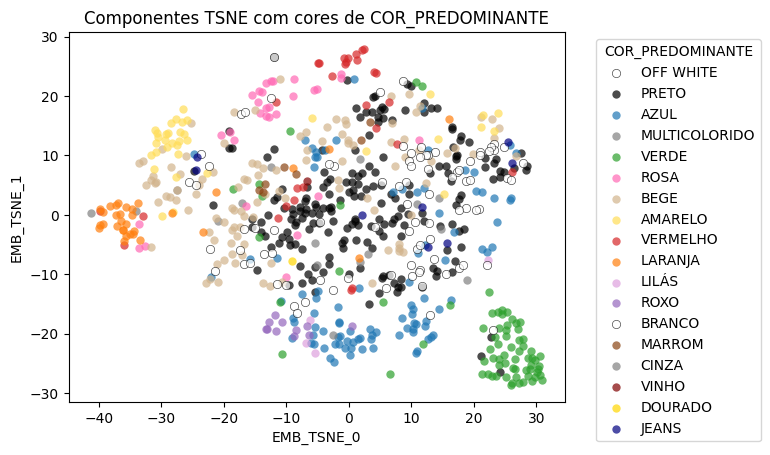

In [341]:
plot_cores(df_img_pca_tsne, cor_column='COR_PREDOMINANTE', reducer='TSNE', color_dict=color_dict)

In [342]:
# Aplicando apply_tsne para visualização dos embeddings de df_img_embs
df_img_pca_umap, umap_img_pca_model = apply_umap(df_img_embs, pca_cols, n_components=2)

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



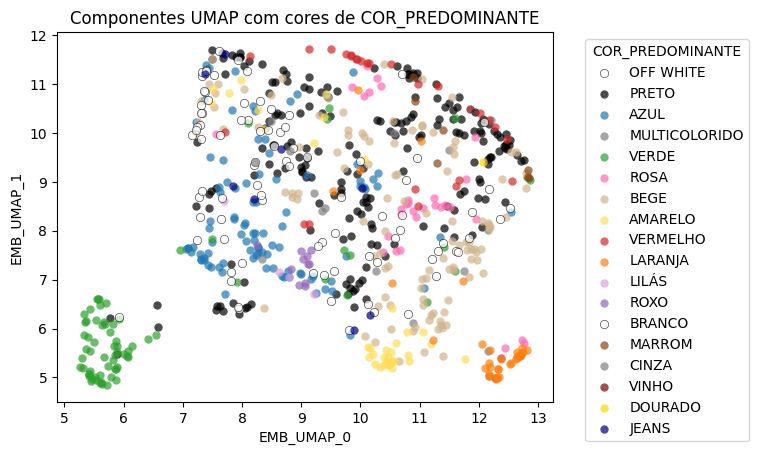

In [343]:
plot_cores(df_img_pca_umap, cor_column='COR_PREDOMINANTE', reducer='UMAP', color_dict=color_dict)

Não deu certo usar as cores sólidas.

animale_images_cropped/blusa/top-blusa_regata-de-malha-rib-basic_off-white_52-15-1506-0003.jpg


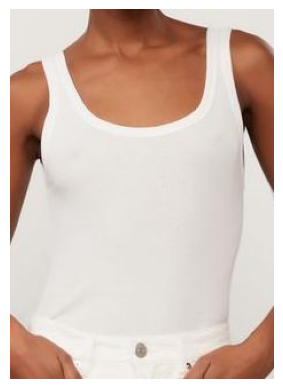

Red color clothing 0.47
Blue color clothing 0.46
Green color clothing 0.38

animale_images_cropped/blusa/top-blusa_regata-de-tricot-vermelho-com-gola-alta-basico_vermelho-argila_52-13-5343-09050.jpg


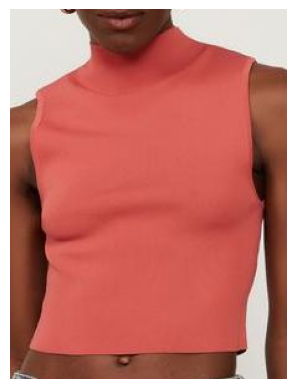

Orange color clothing 0.49
White color clothing 0.37
Purple color clothing 0.32

animale_images_cropped/blusa/camisa_camisa-de-seda-basica-off-white-manga-longa_off-white_52-05-1570-0003.jpg


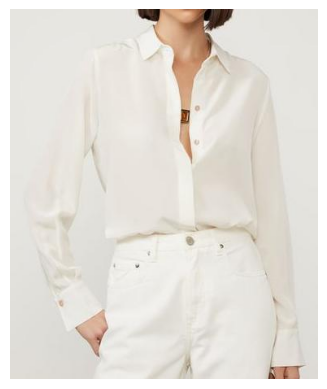

Red color clothing 0.60
White color clothing 0.34
Black color clothing 0.32

animale_images_cropped/calca/calca_calca-jacquard-cenoura-roxa-com-pregas_roxo-mirtilo_25-34-1753-09252.jpg


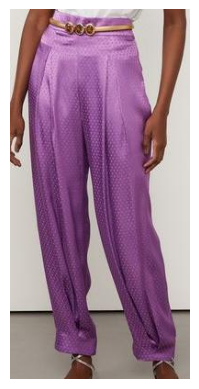

Brown color clothing 0.57
Purple color clothing 0.51
Orange color clothing 0.17

animale_images_cropped/blusa/top-blusa_blusa-de-malha-canelada-verde-com-manga-media_verde-folha_52-06-0688-09258.jpg


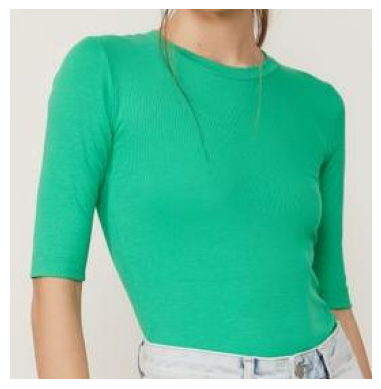

Green color clothing 0.60
Pink color clothing 0.50
Yellow color clothing 0.31



In [347]:
# Pegando 10 imagens aleatórias
sample_indexes = random.sample(range(img_embeddings_pca.shape[0]), 5)
img_embeddings_pca_sample = img_embeddings_pca[sample_indexes]
files = df['file_path'].values[sample_indexes]

# para cada dimensão do vetor de PCA das imagens, escalamos para bater com o mesmo min e max do vetor de cores
for i in range(img_embeddings_pca_sample.shape[1]):
    min_value_color = cores_embeddings_pca[:, i].min()
    max_value_color = cores_embeddings_pca[:, i].max()
    min_value_img = img_embeddings_pca_sample[:, i].min()
    max_value_img = img_embeddings_pca_sample[:, i].max()
    img_embeddings_pca_sample[:, i] = (img_embeddings_pca_sample[:, i] - min_value_img) / (max_value_img - min_value_img) * (max_value_color - min_value_color) + min_value_color


cos_sim = util.cos_sim(img_embeddings_pca_sample, cores_embeddings_pca)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)

  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(description_list[top_3_indices[-i-1]], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

## 2° Abordagem: LDA

In [354]:
df_img_embs = pd.read_parquet('datasets/img_embeddings.parquet')
embs_cols = [col for col in df_img_embs.columns if 'emb_img_' in col]

In [356]:
# Adicionando coluna COR_PREDOMINANTE
df_img_embs = df_img_embs.merge(df[['id_produto', 'COR_PREDOMINANTE']], on='id_produto')

In [392]:
df_img_embs['COR_PREDOMINANTE'].value_counts()

PRETO            195
BEGE             111
AZUL              96
BRANCO            87
VERDE             73
AMARELO           36
LARANJA           32
ROSA              30
VERMELHO          29
OFF_WHITE         29
MULTICOLORIDO     13
ROXO              11
JEANS              8
MARROM             7
LILÁS              4
CINZA              3
VINHO              1
DOURADO            1
Name: COR_PREDOMINANTE, dtype: int64

In [397]:
# DOURADO -> AMARELO
# OFF WHITE -> BRANCO
# JEANS -> AZUL
# VINHO -> ROXO

# Substituindo valores de COR_PREDOMINANTE
df_img_embs['COR_PREDOMINANTE'] = df_img_embs['COR_PREDOMINANTE'].replace({
    'DOURADO': 'AMARELO',
    'OFF_WHITE': 'BRANCO',
    'JEANS': 'AZUL',
    'VINHO': 'ROXO',
    'LILÁS': 'ROXO'
})


In [398]:
df_img_embs['COR_PREDOMINANTE'].value_counts()

PRETO            195
BRANCO           116
BEGE             111
AZUL             104
VERDE             73
AMARELO           37
LARANJA           32
ROSA              30
VERMELHO          29
ROXO              16
MULTICOLORIDO     13
MARROM             7
CINZA              3
Name: COR_PREDOMINANTE, dtype: int64

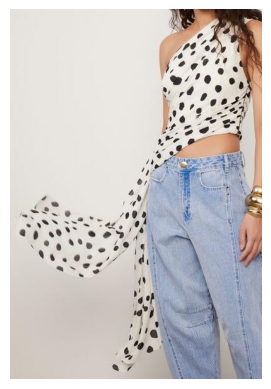

BRANCO



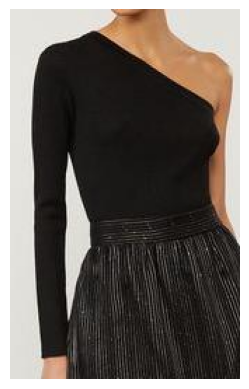

PRETO



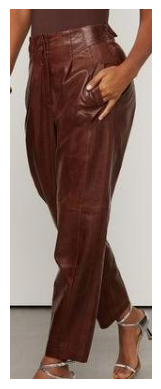

MARROM



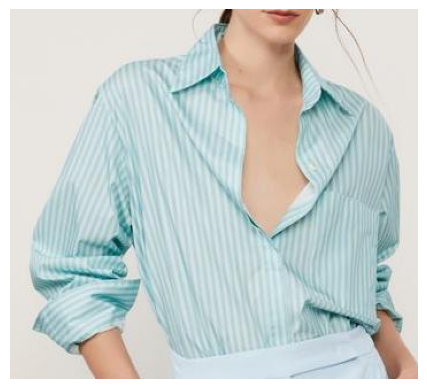

AZUL



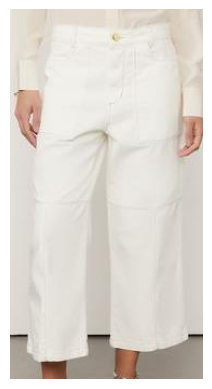

BRANCO



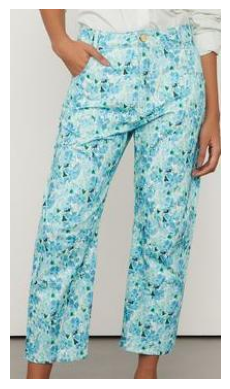

AZUL



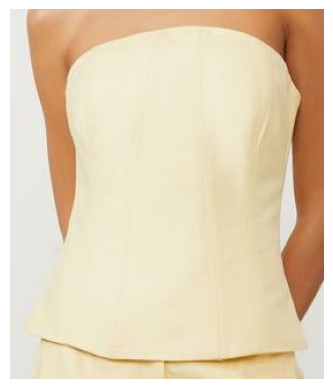

AMARELO



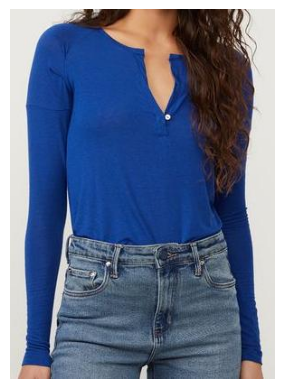

AZUL



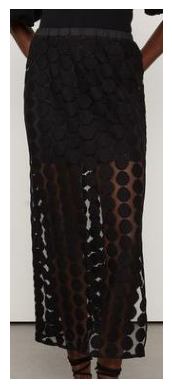

PRETO



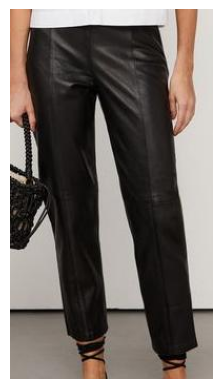

PRETO



In [403]:
# Plotanto algumas imagens e suas respectivas cores
sample_indexes = random.sample(range(df_img_embs.shape[0]), 10)
sample = df.iloc[sample_indexes]

for i, row in sample.iterrows():
    plot_image(row['file_path'])
    print(row['COR_PREDOMINANTE'])
    print()

In [405]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# Função que aplica LDA: recebe um df, as colunas desse df que contêm os embeddings e o número de componentes que se deseja obter
def apply_lda(df, colunas, n_components=2, lda=None):
    """
    Aplica LDA nos embeddings para redução de dimensionalidade com base na coluna 'COR_PREDOMINANTE',
    ignorando valores nulos na coluna de target e retornando um novo DataFrame com as colunas desejadas.
    """
    df_filtered = df.copy()

    if not lda:
        # Inicializando o modelo LDA
        lda = LinearDiscriminantAnalysis(n_components=n_components)

        # Filtrando os dados para remover nulos na coluna 'COR_PREDOMINANTE'
        df_filtered = df_filtered.dropna(subset=['COR_PREDOMINANTE'])

        # Treinando o modelo e transformando os dados
        componentes = lda.fit_transform(df_filtered[colunas], df_filtered['COR_PREDOMINANTE'])

        # Criando um novo DataFrame com as colunas desejadas
        df_lda = df_filtered[['id_produto', 'COR_PREDOMINANTE']].copy()

    else:
        componentes = lda.transform(df_filtered[colunas])

        # Criando um novo DataFrame com as colunas desejadas
        df_lda = df_filtered[['id_produto']].copy()

    for i in range(n_components):
        df_lda[f'EMB_LDA_{i}'] = componentes[:, i]

    return df_lda, lda

In [406]:
# Aplicando LDA e retornando o DataFrame ajustado
df_lda, lda_model  = apply_lda(df_img_embs, embs_cols, 10)

In [407]:
df_lda.sample(5)

,id_produto,COR_PREDOMINANTE,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9
32,25-34-1750-09259,ROSA,-5.636288,-8.131571,-5.181332,7.516912,2.927464,-2.004923,-0.503410,0.277110,0.295541,-9.802520
144,25-34-1772-0109,AZUL,-1.175876,8.716398,4.395674,7.201676,-0.130125,-0.347731,-0.891204,-0.087588,-0.878494,-0.224862
285,52-13-5349-0005,PRETO,8.268752,-3.853425,0.037551,0.555926,-1.157122,-0.318214,0.221447,-2.159839,0.001673,-1.576015
356,52-15-1337-5476,VERDE,-1.981028,8.204623,-7.660537,-5.662332,0.882323,-2.153474,-1.187195,-0.189743,-0.160067,-1.838989
106,25-34-1754-0005,PRETO,9.579849,-1.020060,-1.235833,-1.605403,0.844527,0.520620,0.187319,0.349290,-0.928680,0.332145


In [408]:
# Função t-SNE
colunas_lda = [col for col in df_lda.columns if 'EMB_LDA' in col]

# Aplicando t-SNE e retornando o DataFrame ajustado
df_tsne, tsne_model = apply_tsne(df_lda, colunas_lda, 2)

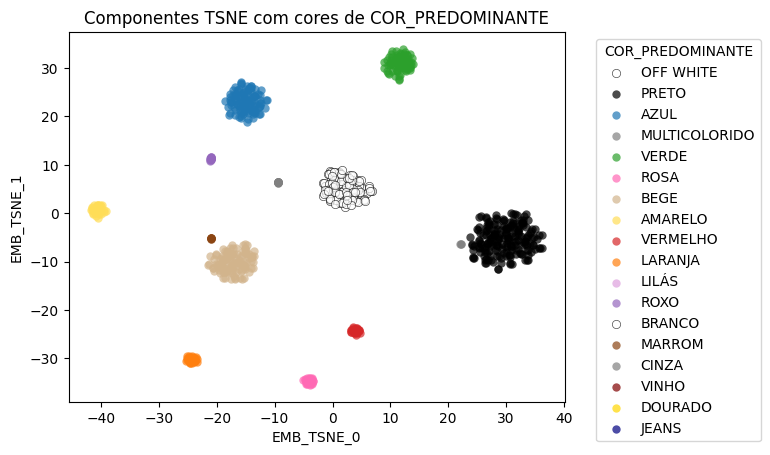

In [409]:
# Plotando o resultado do t-SNE
plot_cores(df_tsne, cor_column='COR_PREDOMINANTE', reducer='TSNE', color_dict=color_dict)

In [410]:
# Mesmo plot agora com UMAP
df_umap, umap_model = apply_umap(df_lda, colunas_lda, 2)

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



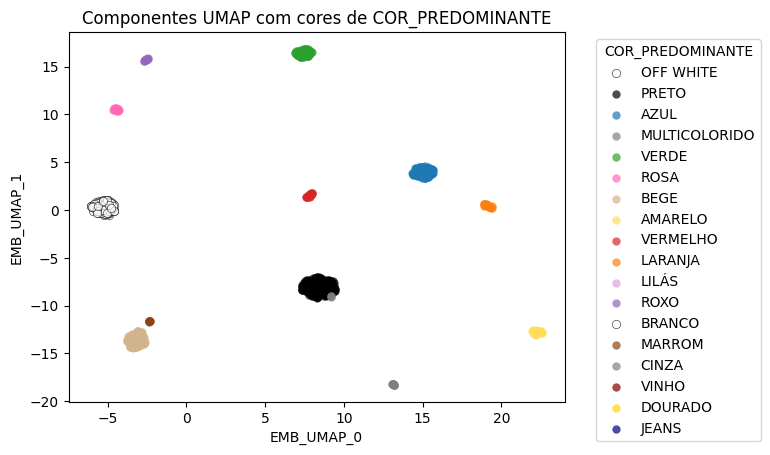

In [411]:
plot_cores(df_umap, cor_column='COR_PREDOMINANTE', reducer='UMAP', color_dict=color_dict)

In [366]:
df_lda

,id_produto,COR_PREDOMINANTE,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9
0,03-04-0464-0030,BEGE,-4.798455,3.695337,2.288457,-2.003521,-1.592693,-0.354486,-2.722168,-1.260372,3.414214,-2.629134
1,03-04-0478-6048,BEGE,-4.417545,4.341016,2.620720,-3.278952,-2.048050,0.196652,0.055423,0.631716,3.206735,-0.437662
2,03-04-0460-0003,BRANCO,-1.902171,1.426444,5.592891,-1.882545,5.421782,-0.004348,0.248192,-0.809425,-3.649487,0.766672
3,03-04-0461-0005,PRETO,8.653065,2.467800,-1.443379,0.433132,-0.858898,-0.574914,0.653396,-0.918952,0.681672,0.360687
4,03-04-0479-0024,BRANCO,-3.356439,0.116161,6.852534,-4.097650,6.811990,-2.022061,1.727669,-1.094308,-2.406021,-1.267751
...,...,...,...,...,...,...,...,...,...,...,...,...
761,07-20-6778-0005,PRETO,9.724433,3.980123,-1.464245,-0.684034,-0.908626,-1.874846,-1.889836,-0.499047,0.371656,-0.488409
762,07-20-6402-09248,LARANJA,-5.893175,4.448529,-1.601606,0.411309,-7.729593,-0.340747,6.869228,-3.255309,-4.237454,-1.115672
763,07-20-6401-0005,PRETO,10.968116,3.989507,-1.508692,0.138626,-0.824181,-0.155543,0.419401,-0.539439,1.885562,-0.537321
764,07-20-6659-09538,BEGE,-4.419074,2.192497,1.972972,-2.954145,-0.996643,-1.287656,-3.467157,-2.766745,3.990124,0.535831


In [378]:
description_list

['Black color clothing',
 'White color clothing',
 'Red color clothing',
 'Yellow color clothing',
 'Green color clothing',
 'Blue color clothing',
 'Purple color clothing',
 'Brown color clothing',
 'Pink color clothing',
 'Orange color clothing']

In [379]:
# Gerar embeddings das cores
cores_embeddings = text_model.encode(description_list)

In [381]:
# Criando um DataFrame com os embeddings das cores
df_cores = pd.DataFrame(cores_embeddings, columns=[f'EMB_{i}' for i in range(cores_embeddings.shape[1])])

In [382]:
df_cores

,EMB_0,EMB_1,EMB_2,EMB_3,EMB_4,EMB_5,EMB_6,EMB_7,EMB_8,EMB_9,...,EMB_502,EMB_503,EMB_504,EMB_505,EMB_506,EMB_507,EMB_508,EMB_509,EMB_510,EMB_511
0,0.278168,0.097347,-0.121005,0.225942,0.205412,-0.335329,0.134802,-0.953954,0.713841,0.055741,...,-0.081756,0.418288,0.564023,-0.275429,-0.340022,0.064276,0.186769,0.396663,0.181738,0.229109
1,-0.172607,-0.100618,0.068171,0.310801,-0.261451,0.011997,0.157111,-1.142312,0.313021,-0.049853,...,0.074723,0.327823,0.489933,-0.192647,0.029983,-0.011370,-0.113517,0.238956,-0.173661,-0.355313
2,-0.004685,0.057948,-0.012902,-0.104870,-0.256735,-0.018734,-0.222060,-0.988953,0.288046,-0.335671,...,0.094969,0.287783,0.201295,-0.242050,-0.211870,0.369214,0.022668,0.009196,-0.047858,0.175221
3,0.190894,0.021499,-0.394829,0.358876,-0.476241,-0.476267,-0.042734,-0.969864,-0.402789,-0.122936,...,0.247761,0.474510,0.427190,-0.279337,-0.195383,0.313402,0.186569,0.251917,0.335263,0.123005
4,0.068577,0.058644,-0.192364,-0.152565,-0.028071,-0.375115,-0.272559,-0.939692,-0.184563,-0.336980,...,0.319813,0.245842,0.934863,-0.340526,-0.313886,-0.117870,0.261369,0.365895,-0.115527,0.548991
5,0.142007,-0.107443,-0.107343,0.270831,-0.161593,-0.287988,-0.184594,-0.957589,0.291378,-0.083405,...,0.395486,0.324208,0.084372,-0.315990,-0.006518,0.327541,-0.193133,0.226212,-0.246319,0.356885
6,0.307044,-0.033291,0.152306,-0.014062,-0.000020,-0.308233,-0.239642,-0.913598,0.534601,0.000610,...,-0.317705,0.180076,0.110751,-0.388912,-0.640781,0.111968,-0.169086,0.258441,0.170404,0.529766
7,0.152276,0.165306,0.088024,0.262012,-0.053606,-0.269901,0.024149,-0.936832,0.275962,0.038449,...,0.080838,0.407161,0.596758,-0.274141,-0.062238,0.082213,0.165570,0.263461,-0.236495,0.028204
8,-0.160903,-0.159415,0.032362,-0.347020,-0.214330,-0.021228,-0.141587,-1.065903,0.601470,0.091697,...,-0.379128,-0.222065,0.128073,-0.241872,-0.178815,0.316976,-0.263631,0.178728,0.248355,0.493439
9,-0.063421,0.234095,0.094671,0.014017,-0.413608,-0.128902,0.075166,-0.829591,-0.189932,-0.077795,...,0.239305,0.496946,0.416146,-0.326126,-0.289860,0.272465,0.089482,0.188419,0.036624,-0.126417


In [383]:
# Usar LDA nos embs das cores
cores_embeddings_lda = lda_model.transform(df_cores.values)

# Criando df_cores_lda 
df_cores_lda = pd.DataFrame(cores_embeddings_lda, columns=[f'EMB_LDA_{i}' for i in range(cores_embeddings_lda.shape[1])])

# Adicionando a coluna com nome da cor (vem de description_list)
df_cores_lda['COR'] = description_list

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py:439: UserWarning:

X does not have valid feature names, but LinearDiscriminantAnalysis was fitted with feature names



In [384]:
df_cores_lda

,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9,COR
0,-99.417744,169.249255,-138.144768,-188.912268,103.555726,-6.831084,-131.807468,104.377872,-101.398911,204.720409,Black color clothing
1,-118.238687,159.149099,-118.624271,-180.011587,106.286069,-6.809257,-113.576020,109.784260,-100.754347,215.401331,White color clothing
2,-118.513361,149.629183,-149.549942,-142.893568,106.492615,-26.804007,-88.235883,89.171394,-90.727139,167.403461,Red color clothing
3,-103.729983,136.493637,-104.854564,-143.686967,61.069714,-2.676686,-73.887012,104.384863,-77.671612,186.829588,Yellow color clothing
4,-90.254424,110.179780,-140.171917,-163.893886,81.957210,-7.987600,-66.223699,90.651352,-81.392809,186.369744,Green color clothing
5,-86.960773,118.143051,-97.068556,-129.547290,90.572746,-6.943869,-94.811138,100.154373,-68.407506,201.296782,Blue color clothing
6,-68.511879,98.950802,-104.973600,-115.233838,90.716497,22.642514,-68.570221,67.830094,-60.163999,152.578835,Purple color clothing
7,-117.301867,143.717485,-120.245856,-170.548996,84.830747,-19.578429,-114.919137,69.333281,-75.362950,175.435202,Brown color clothing
8,-78.384199,134.128352,-110.902777,-130.913890,82.560061,-2.003236,-68.193140,85.318796,-71.673006,198.040047,Pink color clothing
9,-106.881814,131.131070,-112.437674,-129.590654,74.887832,-19.372268,-58.764964,57.040962,-54.983233,146.611205,Orange color clothing


animale_images_cropped/blusa/camisa_camisa-de-manga-presunto_branco_52-05-1455-0002.jpg


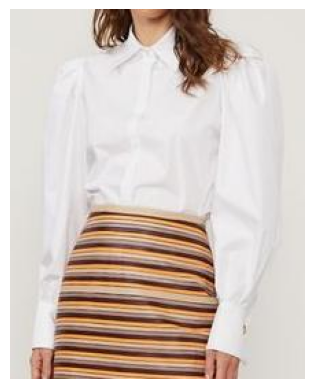

White color clothing 0.18
Yellow color clothing 0.15
Orange color clothing 0.15

animale_images_cropped/calca/calca_calca-de-crepe-off-white_off-white_25-34-2023-0003.jpg


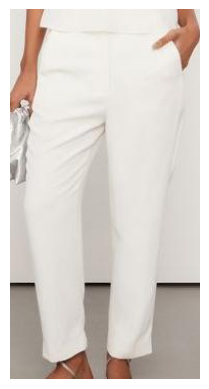

White color clothing 0.31
Purple color clothing 0.28
Blue color clothing 0.28

animale_images_cropped/blusa/top-blusa_regata-de-tricot-alcinha_branco---preto_52-13-5556-0002.jpg


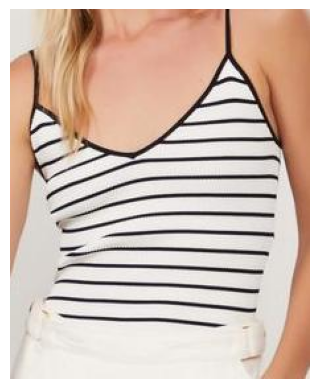

White color clothing 0.19
Black color clothing 0.17
Purple color clothing 0.16

animale_images_cropped/blusa/top-blusa_blusa-de-georgette-frente-unica-verde-franjas_verde-encanto_52-13-5370-09253.jpg


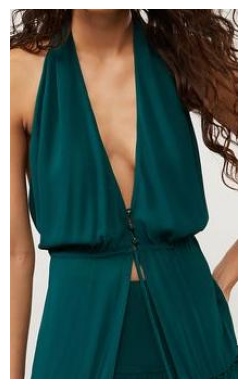

Green color clothing 0.21
Purple color clothing 0.12
Red color clothing 0.11

animale_images_cropped/blusa/top-blusa_top-de-tricot-sem-alca_preto_52-13-5554-0005.jpg


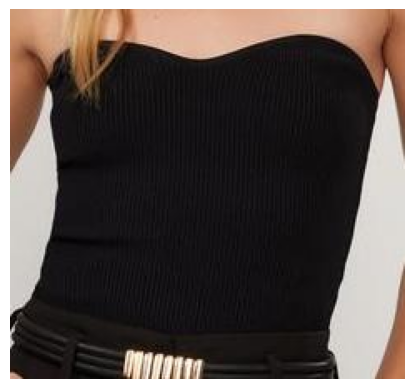

Black color clothing -0.13
Pink color clothing -0.13
Purple color clothing -0.16



In [391]:
# Pegando 10 imagens aleatórias
img_embs_lda = df_lda[colunas_lda].values
sample_indexes = random.sample(range(img_embs_lda.shape[0]), 5)
img_embeddings_lda_sample = img_embs_lda[sample_indexes]
files = df['file_path'].values[sample_indexes]

cos_sim = util.cos_sim(img_embeddings_lda_sample, cores_embeddings_lda)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)

  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(description_list[top_3_indices[-i-1]], f"{scores[top_3_indices[-i-1]]:.2f}")
  print()

In [423]:
df_umap['COR_PREDOMINANTE'].nunique()

13

In [424]:
df_umap

,id_produto,COR_PREDOMINANTE,EMB_UMAP_0,EMB_UMAP_1
0,03-04-0464-0030,BEGE,-3.391729,-13.739964
1,03-04-0478-6048,BEGE,-2.986668,-13.824862
2,03-04-0460-0003,BRANCO,-4.903277,-0.502893
3,03-04-0461-0005,PRETO,8.220956,-8.154054
4,03-04-0479-0024,BRANCO,-5.552527,0.126101
...,...,...,...,...
761,07-20-6778-0005,PRETO,8.048409,-7.406993
762,07-20-6402-09248,LARANJA,19.291971,0.353684
763,07-20-6401-0005,PRETO,8.127141,-7.960863
764,07-20-6659-09538,BEGE,-3.725731,-13.790937


Muuuito melhor com 10 dimensões! Conseguimos ver uma separação mais clara das cores.

Alternativa: pegar a média dos embeddings de cada COR_PREDOMINANTE para setar o centróide de cada cor.

In [465]:
df_lda.columns

Index(['id_produto', 'COR_PREDOMINANTE', 'EMB_LDA_0', 'EMB_LDA_1', 'EMB_LDA_2',
       'EMB_LDA_3', 'EMB_LDA_4', 'EMB_LDA_5', 'EMB_LDA_6', 'EMB_LDA_7',
       'EMB_LDA_8', 'EMB_LDA_9', 'is_centroid'],
      dtype='object')

In [ ]:
apply_umap(df_lda, colunas_lda, 2)

c:\Users\Cole\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



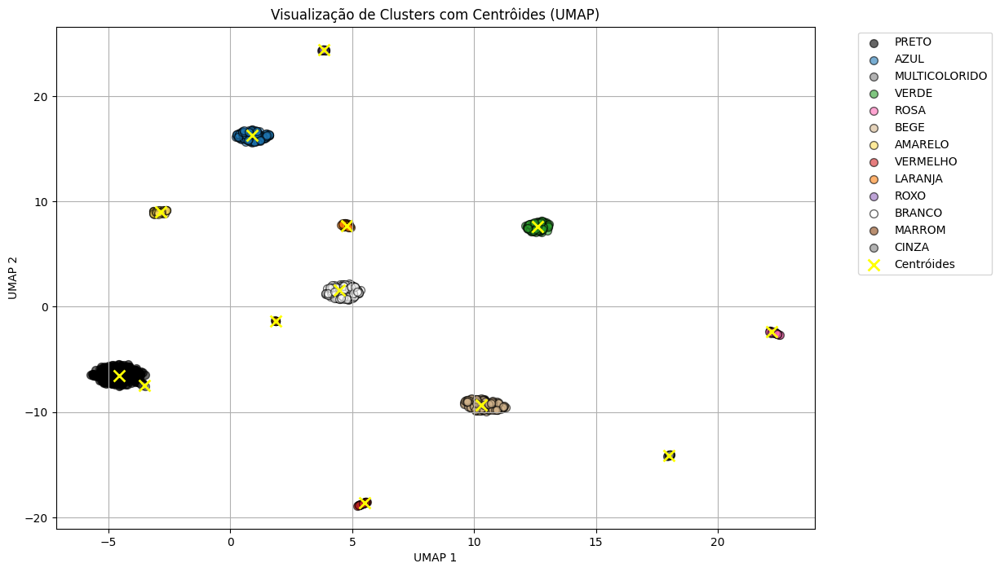

In [469]:
# 1. Calcular os centróides para cada COR_PREDOMINANTE
df_centroides = df_lda.drop(columns={'id_produto'}).groupby('COR_PREDOMINANTE').mean().reset_index()

# 2. Adicionar a coluna 'id_produto' aos centróides
df_centroides['id_produto'] = df_centroides['COR_PREDOMINANTE'].apply(lambda x: f'CLUSTER_{x}')

# 3. Adicionar uma coluna para identificar os centróides
df_centroides['is_centroid'] = True
df_lda['is_centroid'] = False  # Para os dados originais

# 4. Concatenar os dados originais com os centróides
df_combined = pd.concat([df_lda, df_centroides], ignore_index=True)

# 5. Selecionar as colunas de embeddings
colunas_lda = [col for col in df_lda.columns if col.startswith('EMB_LDA')]

# 6. Aplicar UMAP para reduzir a dimensionalidade para 2D
umap_model = UMAP(n_components=2, random_state=42)
umap_result = umap_model.fit_transform(df_combined[colunas_lda])

# 7. Adicionar os resultados do UMAP ao dataframe combinado
df_combined['UMAP_1'] = umap_result[:, 0]
df_combined['UMAP_2'] = umap_result[:, 1]

# 8. Separar os dados originais dos centróides
df_original = df_combined[df_combined['is_centroid'] == False]
df_centroids = df_combined[df_combined['is_centroid'] == True]

# 9. Definir um dicionário de cores para as categorias
# Certifique-se de que todas as categorias em 'COR_PREDOMINANTE' tenham uma cor definida
categorias = df_original['COR_PREDOMINANTE'].unique()
cmap = plt.get_cmap('tab10')  # Escolha um mapa de cores adequado
# Dicionário de cores ajustado para cada valor de COR_PREDOMINANTE
color_dict = {
    'PRETO': '#000000',           # Preto puro
    'AZUL': '#1f77b4',            # Azul padrão
    'MULTICOLORIDO': '#808080',    # Cinza (para representar múltiplas cores de forma neutra)
    'VERDE': '#2ca02c',           # Verde padrão
    'ROSA': '#ff69b4',            # Rosa vibrante
    'BEGE': '#D2B48C',            # Bege suave
    'AMARELO': '#ffdd57',         # Amarelo claro
    'VERMELHO': '#d62728',        # Vermelho escuro
    'LARANJA': '#ff7f0e',         # Laranja padrão
    'ROXO': '#9467bd',            # Roxo médio
    'BRANCO': '#FFFFFF',          # Branco puro
    'MARROM': '#8B4513',          # Marrom escuro
    'CINZA': '#808080',           # Cinza médio
}
# 10. Plotar os dados
plt.figure(figsize=(12, 8))

# Plotar os dados originais
for categoria, cor in color_dict.items():
    subset = df_original[df_original['COR_PREDOMINANTE'] == categoria]
    plt.scatter(subset['UMAP_1'], subset['UMAP_2'],
                c=[cor],
                label=categoria,
                alpha=0.6,
                edgecolor='k',
                s=50)

# Plotar os centróides com marcador 'X'
plt.scatter(df_centroids['UMAP_1'], df_centroids['UMAP_2'],
            marker='x',
            s=100,
            c='yellow',
            linewidths=2,
            label='Centróides')

plt.title('Visualização de Clusters com Centrôides (UMAP)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.show()


In [473]:
df_centroides

,COR_PREDOMINANTE,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9,is_centroid,id_produto
0,AMARELO,-6.513794,-3.406450,0.933514,-2.675184,-6.920312,7.407063,-2.787222,-4.656389,2.719460,-0.840962,True,CLUSTER_AMARELO
1,AZUL,-0.546344,6.809042,5.132366,5.883199,-1.797219,-1.137951,-1.018032,-0.276050,-0.185874,-0.314891,True,CLUSTER_AZUL
2,BEGE,-5.141973,-2.817102,1.569719,-3.349544,-1.355204,-0.903831,-1.946671,2.418986,-3.293365,0.390464,True,CLUSTER_BEGE
3,BRANCO,-2.374926,-0.526231,4.563146,-3.248972,5.252867,-0.022213,1.453453,-0.589211,2.245727,0.125191,True,CLUSTER_BRANCO
4,CINZA,3.411845,-0.691104,-0.134874,3.035107,3.305755,-2.313144,-1.500579,0.493387,-0.207989,-3.281207,True,CLUSTER_CINZA
5,LARANJA,-6.027830,-3.619981,-3.044225,1.446933,-7.628757,-4.913082,7.756941,1.196852,4.235372,1.640154,True,CLUSTER_LARANJA
6,MARROM,-4.396211,-3.754681,-2.989054,1.582376,0.139017,-2.207470,-0.985339,9.707772,1.387029,4.119900,True,CLUSTER_MARROM
7,MULTICOLORIDO,-2.214090,2.030546,-0.846114,1.416852,1.663576,4.615108,12.324459,-7.064237,-11.659578,2.320776,True,CLUSTER_MULTICOLORIDO
8,PRETO,9.193958,-2.376865,-0.419368,-0.159068,-0.618658,0.115263,-0.113284,-0.006858,-0.041117,0.088414,True,CLUSTER_PRETO
9,ROSA,-5.546884,-6.886937,-5.779180,6.218138,3.121777,-2.931663,-0.267364,-1.669021,-0.808780,-8.481403,True,CLUSTER_ROSA


animale_images_cropped/vestido/vestido_vestido-de-seda-midi-preto-borda-festone_preto_07-20-6810-0005.jpg


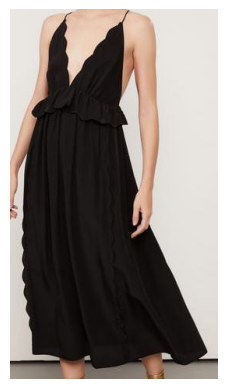

PRETO 0.97
CINZA 0.31
MULTICOLORIDO -0.03
animale_images_cropped/calca/calca_calca-cargo-acetinada_bege-gergelim_25-34-1595-09247.jpg


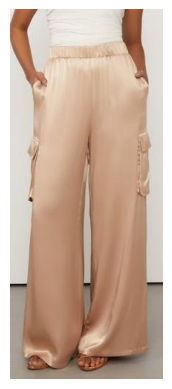

BEGE 0.97
MARROM 0.55
AMARELO 0.28
animale_images_cropped/blazer/blazer_blazer-transpassado-mix-la-lilas-nuvem_lilas-nuvem_03-04-0439-09040.jpg


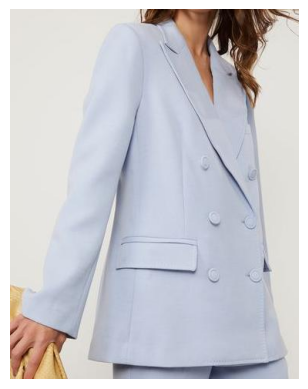

AZUL 0.98
CINZA 0.12
ROXO 0.09
animale_images_cropped/calca/calca_calca-de-crepe-off-white_off-white_25-34-2023-0003.jpg


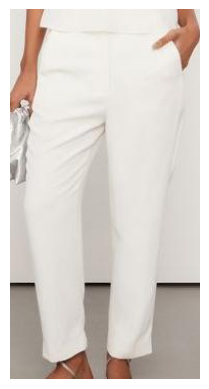

BRANCO 0.97
BEGE 0.16
CINZA 0.04
animale_images_cropped/short/short_bermuda-jeans-wide_jeans-medio_25-05-4073-0105.jpg


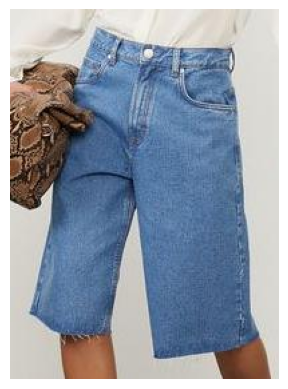

AZUL 0.99
CINZA 0.10
ROXO 0.02
animale_images_cropped/blusa/camisa_camisa-de-seda-polo-rosa-manga-curta_rosa-strawberry_52-05-1564-04528.jpg


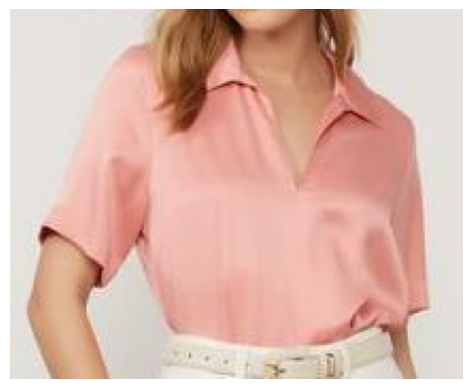

ROSA 0.98
CINZA 0.45
VERMELHO 0.38
animale_images_cropped/vestido/vestido_vestido-um-ombro-sofia_preto_07-20-5723-0005.jpg


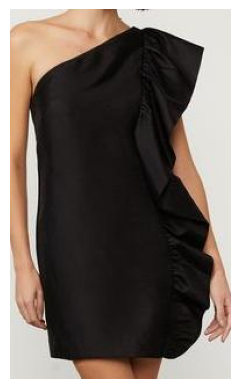

PRETO 0.98
CINZA 0.56
ROXO -0.09
animale_images_cropped/vestido/vestido_vestido-tricot-transparencia_preto_07-20-6778-0005.jpg


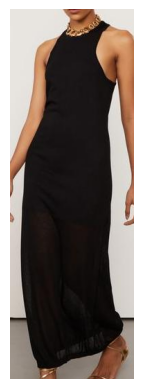

PRETO 0.96
CINZA 0.42
VERMELHO -0.10
animale_images_cropped/vestido/vestido_vestido-de-twill-midi-corset-nude_nude-marzipan_07-20-6500-09251.jpg


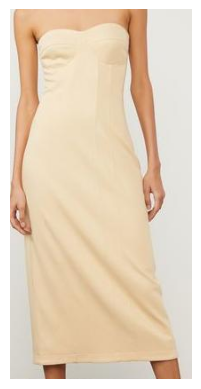

BEGE 0.97
MARROM 0.41
AMARELO 0.22
animale_images_cropped/vestido/vestido_vestido-ondas_preto_07-20-6483-0005.jpg


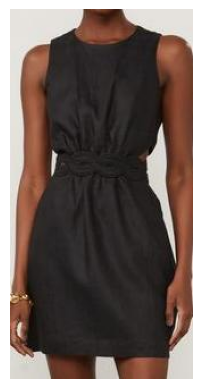

PRETO 0.95
CINZA 0.38
MULTICOLORIDO 0.04
animale_images_cropped/vestido/vestido_vestido-de-georgette-midi-vermelho-frente-unica-franjas_vermelho-argila_07-20-6478-09050.jpg


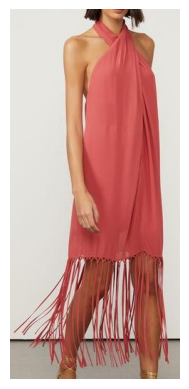

ROSA 0.98
CINZA 0.45
VERMELHO 0.42
animale_images_cropped/blusa/camisa_camisa-ampla-de-linho-off-white_off-white_52-05-1566-0003.jpg


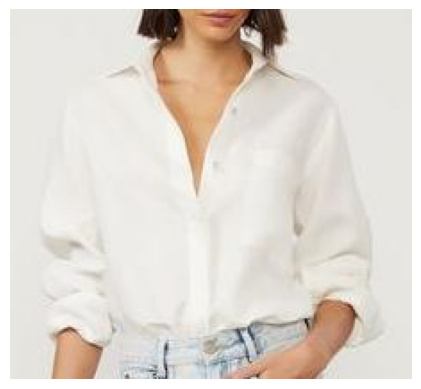

BRANCO 0.97
BEGE 0.15
MARROM 0.01
animale_images_cropped/blusa/top-blusa_top-de-tricot-faixa-cruzado-basic_branco_52-10-5210-0002.jpg


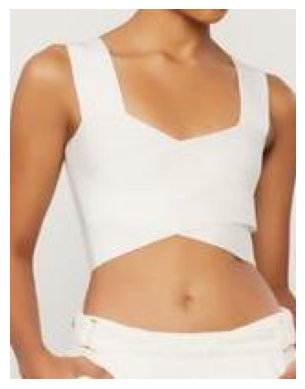

BRANCO 0.91
CINZA 0.17
AZUL 0.13
animale_images_cropped/blusa/top-blusa_regata-de-couro-alca-rolote_verde-folha_52-15-1397-09258.jpg


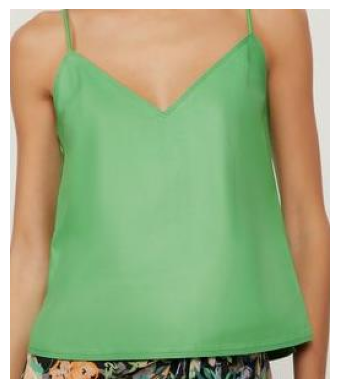

VERDE 0.99
MULTICOLORIDO 0.07
ROXO 0.02
animale_images_cropped/calca/calca_calca-duo-preta_preto_25-34-1599-0005.jpg


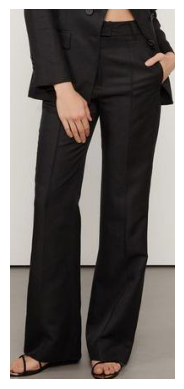

PRETO 0.94
CINZA 0.39
AMARELO -0.14
animale_images_cropped/calca/calca_calca-reta-de-ggt-com-fendas-laterais-ma_marinho-sodalita_25-34-1633-6215.jpg


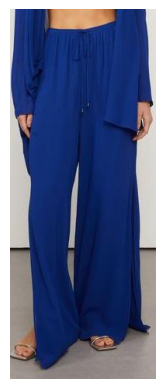

AZUL 0.98
CINZA 0.19
ROXO 0.14
animale_images_cropped/vestido/vestido_vestido-de-tule-midi-onca-com-detalhe-lateral-franzida_est-onca-solsticio_07-20-6933-09905.jpg


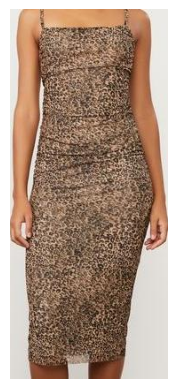

BEGE 0.98
MARROM 0.57
AMARELO 0.32
animale_images_cropped/vestido/vestido_vestido-de-malha-midi-verde-com-detalhe-entrelacado_verde-encanto_07-20-6550-09253.jpg


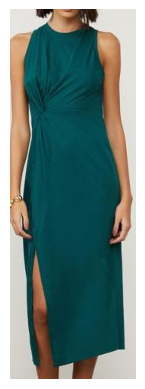

VERDE 0.96
MULTICOLORIDO 0.11
AMARELO 0.01
animale_images_cropped/vestido/vestido_vestido-de-malha-crepe-manga-bombom-preto_preto_07-20-6614-0005.jpg


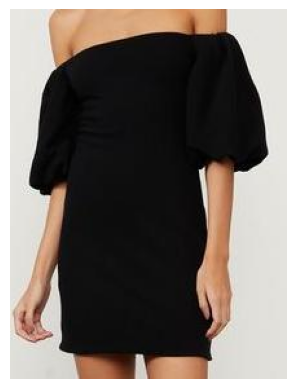

PRETO 0.96
CINZA 0.55
MARROM -0.13
animale_images_cropped/blusa/top-blusa_blusa-de-georgette-com-decote-de-babado-estampado_est--floral-carimbo-golden_52-13-5529-09738.jpg


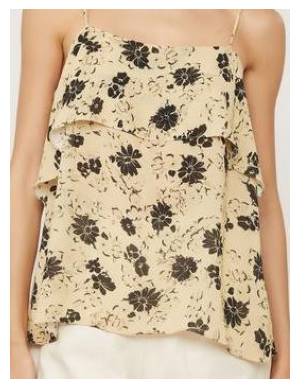

BEGE 0.85
AMARELO 0.53
MARROM 0.24
animale_images_cropped/blusa/top-blusa_blusa-manga-longa-com-decote-v-listra_est-listra-bicolor-narciso-e-sandalo-p--_52-13-5287-09552.jpg


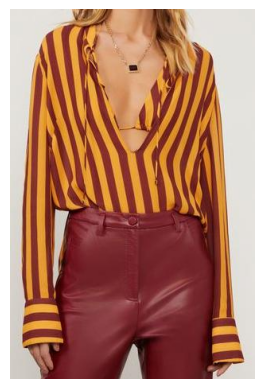

AMARELO 0.99
BEGE 0.38
LARANJA 0.23
animale_images_cropped/blusa/top-blusa_regata-de-malha-rib-com-decote-nadador_preto_52-15-1407-0005.jpg


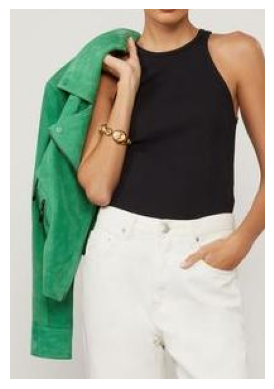

PRETO 0.95
CINZA 0.50
VERDE -0.06
animale_images_cropped/blazer/blazer_blazer-uno-bege-madeira_bege-madeira_03-04-0467-0800.jpg


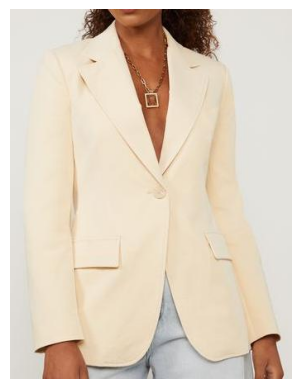

BEGE 0.95
BRANCO 0.43
AMARELO 0.33
animale_images_cropped/calca/calca_calca-de-couro-recortes-vermelho-argila_vermelho-argila_25-34-1730-09050.jpg


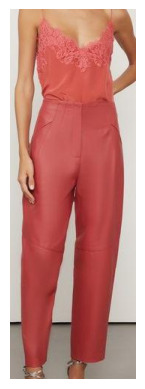

ROSA 0.98
VERMELHO 0.47
CINZA 0.47
animale_images_cropped/blusa/top-blusa_regata-de-tricot-verde-com-decote-quadrado_verde-natureza_52-15-1376-09255.jpg


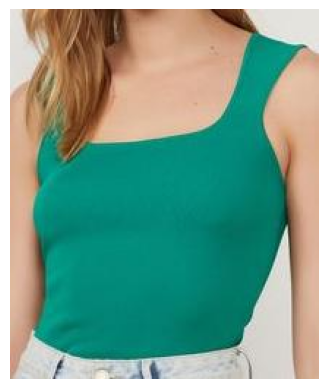

VERDE 0.98
ROXO 0.15
MULTICOLORIDO 0.06
animale_images_cropped/calca/calca_calca-amarelo-papiro_amarelo-papiro_25-34-1744-01011.jpg


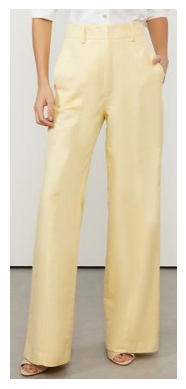

AMARELO 0.96
BEGE 0.50
LARANJA 0.28
animale_images_cropped/blusa/top-blusa_top-de-tricot-verde-com-manga-longa-canelado-basico_verde-vivo_52-13-5288-5476.jpg


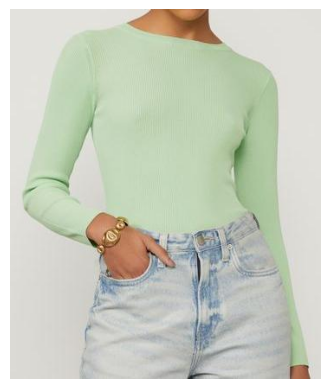

VERDE 0.98
MULTICOLORIDO 0.06
VERMELHO 0.02
animale_images_cropped/calca/calca_calca-duo-off-white_off-white_25-34-1598-0003.jpg


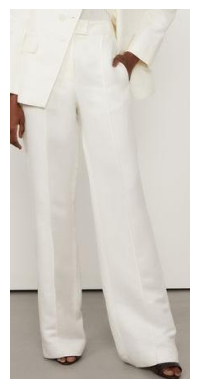

BRANCO 0.97
BEGE 0.15
VERMELHO 0.00
animale_images_cropped/blusa/top-blusa_t-shirt-de-malha-verde-com-manga-curta_verde-folha_52-06-0693-09258.jpg


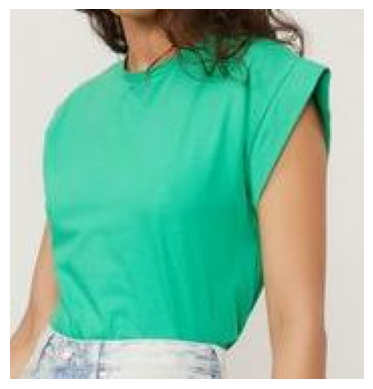

VERDE 0.99
MULTICOLORIDO 0.09
AZUL -0.03
animale_images_cropped/calca/calca_calca-de-georgette-pesado-ampla-estampada_est-xadrez-daisy-kirli-e-cannes_25-34-1718-09634.jpg


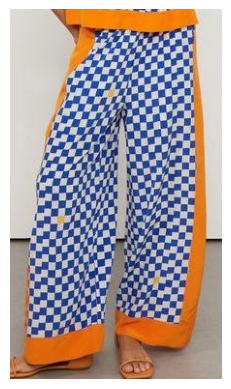

AZUL 0.99
CINZA 0.18
MULTICOLORIDO -0.04



In [480]:
# Pegando 10 imagens aleatórias
img_embs_lda = df_lda[colunas_lda].values
sample_indexes = random.sample(range(img_embs_lda.shape[0]), 30)
img_embeddings_lda_sample = img_embs_lda[sample_indexes]
files = df['file_path'].values[sample_indexes]

cos_sim = util.cos_sim(img_embeddings_lda_sample, df_centroides[colunas_lda].values)

# para cada imagem, vendo a semelhança com cada cor
for file_name, scores in zip(files, cos_sim):
  print(file_name)
  plot_image(file_name)

  # top 3 colors:
  scores = scores.numpy()
  top_3_indices = scores.argsort()
  for i in range(3):
    print(df_centroides.iloc[top_3_indices[-i-1]]['COR_PREDOMINANTE'], f"{scores[top_3_indices[-i-1]]:.2f}")
print()

Muuuito melhor com 10 dimensões! Conseguimos ver uma separação mais clara das cores.\

O modelo está dando conta de classificar a cor do produto corretamente apenas olhando pro embedding da imagem.

# Testando busca

In [632]:
# Gerando os embeddings das imagens teste
pasta = "teste_images"

# Criando lista com as image_paths da pasta
image_paths = [os.path.join(pasta, path).replace('\\','/') for path in os.listdir(pasta)]

# Criando um df_color com os nomes das imagens
df_teste = pd.DataFrame(image_paths, columns=["image_path"])


In [633]:
# Now we load and encode the images
def load_image(url_or_path):
    if url_or_path.startswith("http://") or url_or_path.startswith("https://"):
        return Image.open(requests.get(url_or_path, stream=True).raw)
    else:
        return Image.open(url_or_path)

file_names = df_teste['image_path'].values
images = [load_image(img) for img in file_names]
img_embeddings = img_model.encode(images)

img_embeddings

array([[ 0.02259515, -0.09865645, -0.0290992 , ...,  0.7115479 ,
        -0.41434473,  0.56446445],
       [-0.06295233,  0.01890525, -0.12194834, ...,  0.15583399,
        -0.168661  ,  0.58694273],
       [-0.2468163 ,  0.23940614, -0.3174309 , ...,  0.594273  ,
        -0.43305337,  0.13149756],
       ...,
       [ 0.12463398, -0.3037274 , -0.02213591, ...,  0.55207616,
         0.06693589,  0.34842932],
       [ 0.31417406, -0.238452  , -0.05673251, ...,  0.04833928,
        -0.21209984,  0.50992846],
       [ 0.08402456, -0.07418055, -0.13874753, ...,  0.40317976,
        -0.05153633,  0.10584958]], dtype=float32)

In [634]:
# Adicionando embeddings em df_teste
emb_dict = {}

for i, emb in enumerate(img_embeddings):
    emb_id = df_teste.iloc[i]["image_path"]
    emb_dict[emb_id] = emb

df_teste_embs = pd.DataFrame(emb_dict).T

# Renomeando as colunas de embedding para emb_i
df_teste_embs.columns = [f'emb_img_{i}' for i in range(df_teste_embs.shape[1])]


In [635]:
lda_model


LinearDiscriminantAnalysis(n_components=10)

In [636]:
df_teste_embs

,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,emb_img_9,...,emb_img_502,emb_img_503,emb_img_504,emb_img_505,emb_img_506,emb_img_507,emb_img_508,emb_img_509,emb_img_510,emb_img_511
teste_images/VESTIDO_AZUL.png,0.022595,-0.098656,-0.029099,0.567702,-0.562149,0.065461,-0.195253,-0.300731,0.367395,0.107400,...,0.067679,-0.377808,-0.037915,-0.205793,0.097149,-0.060826,0.037285,0.711548,-0.414345,0.564464
teste_images/VESTIDO_CIANO.png,-0.062952,0.018905,-0.121948,0.007386,-0.161697,0.111981,-0.268656,0.237585,0.651879,-0.275347,...,0.219109,-0.208903,0.505170,-0.054623,0.023165,0.211817,0.141975,0.155834,-0.168661,0.586943
teste_images/VESTIDO_LISTRADO.png,-0.246816,0.239406,-0.317431,0.397968,-0.143012,0.335053,0.085922,0.136599,0.506718,-0.036190,...,0.216211,-0.094713,0.319507,-0.469476,0.193140,0.003130,-0.171389,0.594273,-0.433053,0.131498
teste_images/VESTIDO_MARROM.png,0.137735,0.187964,-0.030165,0.146878,-0.452270,0.270015,-0.183899,0.258470,0.667568,0.012360,...,0.112846,-0.226068,0.513181,-0.111401,0.008002,0.311027,0.055253,0.552292,-0.168289,0.206410
teste_images/VESTIDO_MARROM_2.png,-0.291701,-0.018742,-0.069712,0.075746,-0.119037,0.126561,-0.144355,-0.246068,0.475600,0.022687,...,0.007640,-0.197631,0.584562,-0.074490,0.133096,-0.156897,0.230855,0.756065,-0.477595,0.192697
teste_images/VESTIDO_ROXO.png,0.124634,-0.303727,-0.022136,0.342569,-0.422898,0.121094,-0.266027,0.140250,0.904812,-0.045872,...,0.021772,-0.041850,0.121323,-0.118815,0.038153,-0.024812,0.233595,0.552076,0.066936,0.348429
teste_images/VESTIDO_VERDE.png,0.314174,-0.238452,-0.056733,0.088339,-0.422520,0.088575,0.144455,0.415287,0.372337,-0.214220,...,0.199320,-0.111156,0.449900,0.199686,0.187086,-0.536322,0.078007,0.048339,-0.212100,0.509928
teste_images/VESTIDO_VERMELHO.png,0.084025,-0.074181,-0.138748,0.342731,-0.131960,0.477358,-0.196876,0.270788,0.580135,-0.107066,...,0.097421,-0.385517,-0.025575,-0.008097,-0.044830,-0.019088,0.096439,0.403180,-0.051536,0.105850


In [637]:
colunas_embs = [col for col in df_teste_embs.columns if 'emb_img' in col]

In [638]:
df_teste_embs.reset_index(inplace=True)

In [639]:
# Renomear index para id_produto
df_teste_embs.rename(columns={'index': 'id_produto'}, inplace=True)

In [640]:
# Aplicando mesmo LDA usado no treinamento
img_embs_teste_lda, lda_model = apply_lda(df_teste_embs, colunas_embs, 10, lda=lda_model)

In [641]:
img_embs_teste_lda

,id_produto,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9
0,teste_images/VESTIDO_AZUL.png,1.206949,4.200676,12.312710,2.746724,-7.894183,-0.533214,-3.169938,0.784738,-2.177790,9.194766
1,teste_images/VESTIDO_CIANO.png,-0.842599,5.429700,-2.473902,-4.311557,-0.378812,-1.700449,-0.083903,-1.509285,-3.654183,-4.954763
2,teste_images/VESTIDO_LISTRADO.png,7.643853,-4.840489,3.673870,-1.792219,3.326326,0.566991,-2.529860,-7.168198,4.006506,-2.837919
3,teste_images/VESTIDO_MARROM.png,-0.873111,1.534213,-5.291064,3.914009,3.313704,-2.301411,4.658180,3.286316,-0.623360,0.871365
4,teste_images/VESTIDO_MARROM_2.png,-4.891588,4.162827,-4.535796,-0.414617,1.155607,0.263764,7.112087,-2.305465,1.527069,10.188649
5,teste_images/VESTIDO_ROXO.png,0.115062,7.303106,-4.426639,11.985817,0.922451,7.223935,4.753663,8.727475,1.152862,7.356528
6,teste_images/VESTIDO_VERDE.png,5.117183,15.896765,-11.282075,3.128803,11.231863,-5.557952,-2.009484,-0.734458,-10.080219,0.931676
7,teste_images/VESTIDO_VERMELHO.png,-0.754376,0.462047,-9.551081,7.555394,6.486330,-1.243521,-9.180934,-1.290593,3.670233,2.983793


In [642]:
img_embs_lda = df_lda[colunas_lda]
img_embs_lda

,EMB_LDA_0,EMB_LDA_1,EMB_LDA_2,EMB_LDA_3,EMB_LDA_4,EMB_LDA_5,EMB_LDA_6,EMB_LDA_7,EMB_LDA_8,EMB_LDA_9
0,-4.612493,-3.678349,1.728147,-2.441147,-1.052707,-0.023659,-1.796217,3.090048,-3.601199,1.162242
1,-4.693364,-4.006449,1.871645,-3.504627,-2.072891,0.598166,0.116953,-0.096825,-3.521633,0.357464
2,-2.538794,-1.575228,5.117051,-2.339249,4.911545,-0.505520,-0.095888,0.062169,3.650489,-0.554855
3,8.600836,-2.577406,-1.403589,0.417611,-0.607053,-1.039741,0.848860,0.373758,-1.044476,-0.783608
4,-4.017709,0.025236,6.253312,-4.743942,6.561825,-1.887124,1.136675,0.961716,2.296356,0.818656
...,...,...,...,...,...,...,...,...,...,...
761,9.928578,-4.234313,-1.150511,-0.932721,-0.596168,-1.567239,-1.486827,-0.427811,-0.208780,1.349933
762,-5.895268,-4.017624,-2.132404,0.733570,-7.876887,-3.364087,5.762025,0.900114,4.678587,1.025169
763,10.895196,-3.914337,-1.381806,0.085476,-0.584896,-0.252824,0.759549,0.802670,-1.885584,0.088204
764,-4.362687,-2.289843,1.427536,-3.248834,-0.726196,-2.025339,-2.443264,2.217101,-4.184645,-1.213252


In [643]:
img_embs_teste_lda[colunas_lda].values

array([[  1.20694936,   4.2006764 ,  12.31270951,   2.74672439,
         -7.89418264,  -0.53321354,  -3.16993767,   0.78473827,
         -2.17778987,   9.19476604],
       [ -0.84259913,   5.42969975,  -2.47390232,  -4.3115566 ,
         -0.37881238,  -1.70044894,  -0.08390259,  -1.50928501,
         -3.65418296,  -4.95476348],
       [  7.64385324,  -4.84048886,   3.67387027,  -1.79221864,
          3.32632578,   0.56699088,  -2.52986024,  -7.16819793,
          4.00650575,  -2.83791938],
       [ -0.87311107,   1.53421264,  -5.29106433,   3.91400886,
          3.31370397,  -2.30141064,   4.65818014,   3.28631569,
         -0.62335987,   0.87136456],
       [ -4.89158824,   4.16282729,  -4.53579647,  -0.41461736,
          1.15560716,   0.26376427,   7.11208658,  -2.30546468,
          1.52706895,  10.18864878],
       [  0.115062  ,   7.30310567,  -4.42663896,  11.98581653,
          0.92245117,   7.2239352 ,   4.75366309,   8.72747531,
          1.15286211,   7.3565282 ],
       [  

Dimensões de cos_sim: torch.Size([8, 766])
Imagem de Teste: teste_images/VESTIDO_AZUL.png


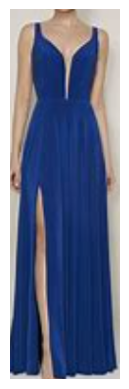

Similaridade com vestido azul:  tensor(0.6486, dtype=torch.float64)
Similaridade: 25-11-1280-0105 - Score: 0.74


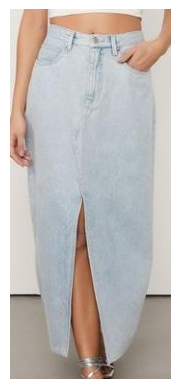

Similaridade: 52-05-1637-04331 - Score: 0.73


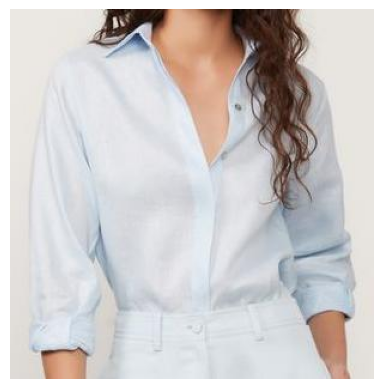

Similaridade: 25-34-1442-09040 - Score: 0.73


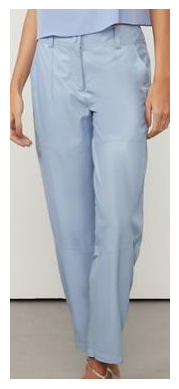


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_CIANO.png


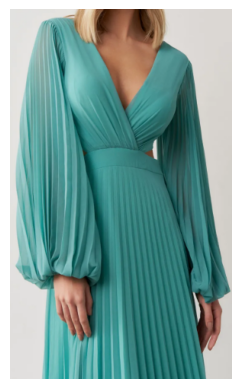

Similaridade com vestido azul:  tensor(0.0431, dtype=torch.float64)
Similaridade: 07-20-6437-09255 - Score: 0.80


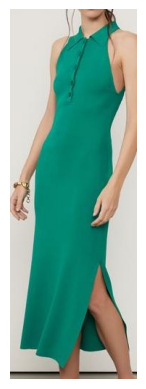

Similaridade: 52-15-1337-5476 - Score: 0.79


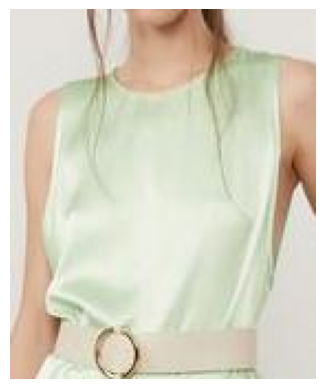

Similaridade: 52-06-0693-09258 - Score: 0.77


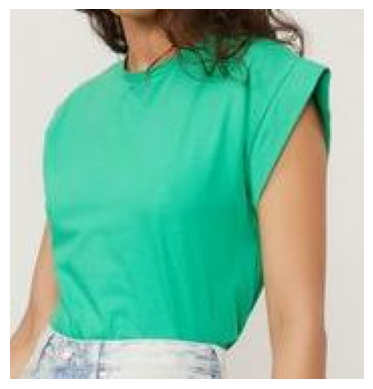


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_LISTRADO.png


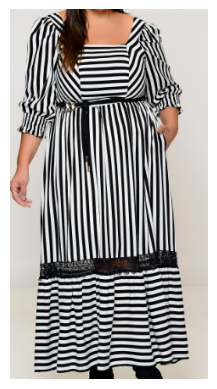

Similaridade com vestido azul:  tensor(-0.1527, dtype=torch.float64)
Similaridade: 52-13-5557-0005 - Score: 0.80


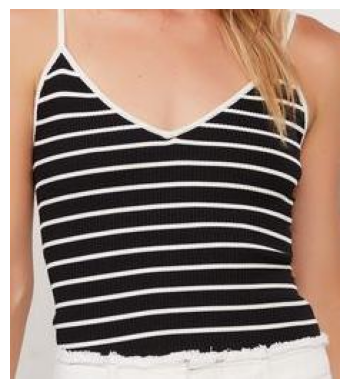

Similaridade: 25-34-1202-0005 - Score: 0.77


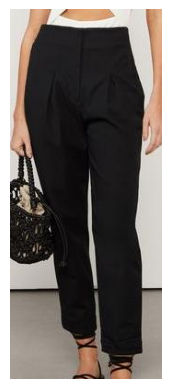

Similaridade: 52-10-5147-0005 - Score: 0.75


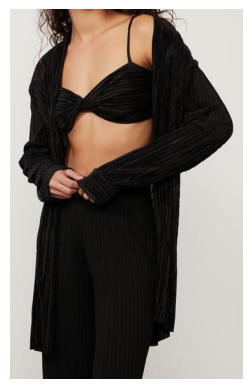


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_MARROM.png


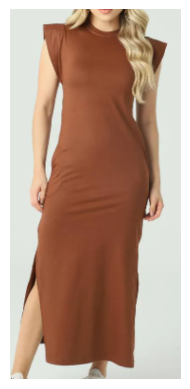

Similaridade com vestido azul:  tensor(-0.1478, dtype=torch.float64)
Similaridade: 25-34-2037-09281 - Score: 0.56


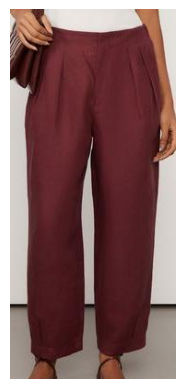

Similaridade: 07-20-6594-09561 - Score: 0.55


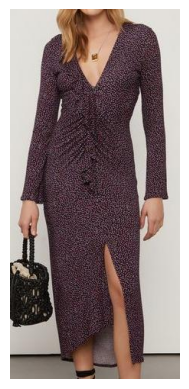

Similaridade: 25-05-4080-09252 - Score: 0.54


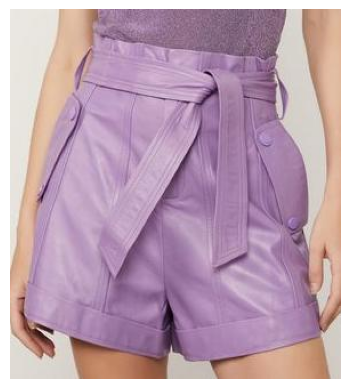


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_MARROM_2.png


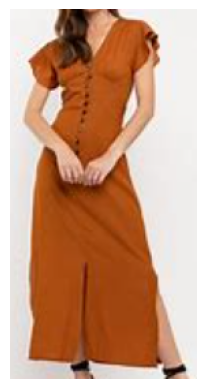

Similaridade com vestido azul:  tensor(-0.0911, dtype=torch.float64)
Similaridade: 52-15-1408-09249 - Score: 0.62


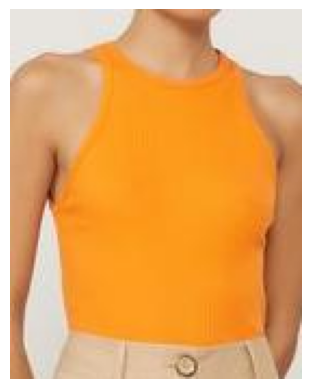

Similaridade: 07-20-6355-09253 - Score: 0.58


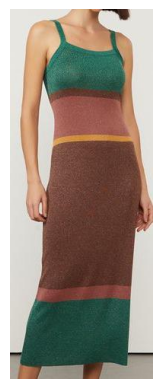

Similaridade: 52-10-5135-6048 - Score: 0.53


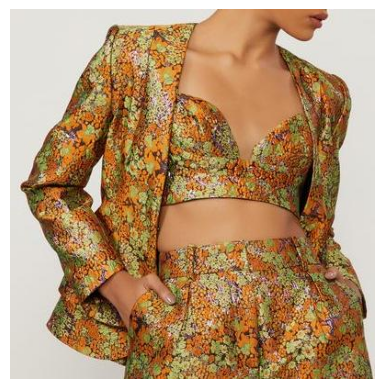


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_ROXO.png


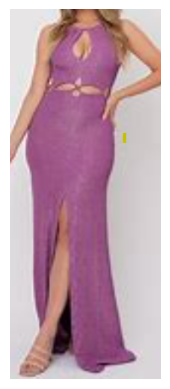

Similaridade com vestido azul:  tensor(0.1742, dtype=torch.float64)
Similaridade: 25-34-2037-09281 - Score: 0.86


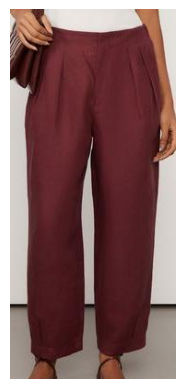

Similaridade: 52-15-1381-09252 - Score: 0.85


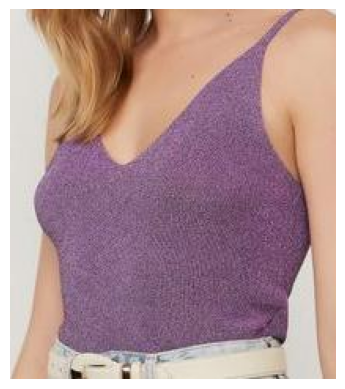

Similaridade: 07-20-6484-09561 - Score: 0.84


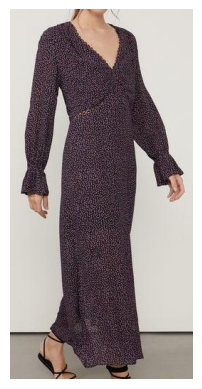


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_VERDE.png


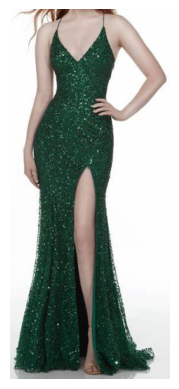

Similaridade com vestido azul:  tensor(0.0646, dtype=torch.float64)
Similaridade: 25-34-1723-09253 - Score: 0.76


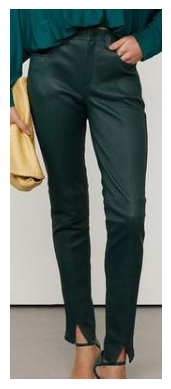

Similaridade: 52-15-1376-09255 - Score: 0.72


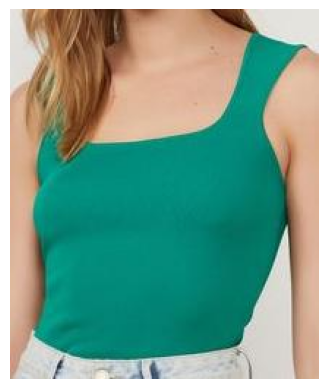

Similaridade: 07-20-6611-09539 - Score: 0.72


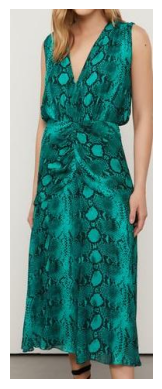


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_VERMELHO.png


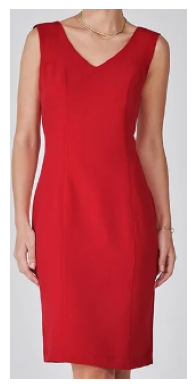

Similaridade com vestido azul:  tensor(-0.1185, dtype=torch.float64)
Similaridade: 07-20-6585-0402 - Score: 0.88


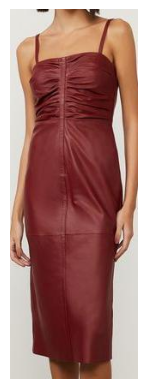

Similaridade: 07-20-6419-8259 - Score: 0.87


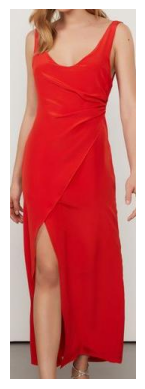

Similaridade: 52-15-1370-8259 - Score: 0.86


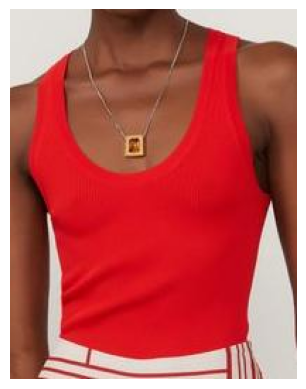


--------------------------------------------------



In [659]:
import torch  # Se estiver usando PyTorch
import pandas as pd
import matplotlib.pyplot as plt
from sentence_transformers import util  # Certifique-se de que está usando a função correta


# Inverter a ordem dos argumentos
cos_sim = util.cos_sim(img_embs_teste_lda[colunas_lda].values, img_embs_lda[colunas_lda].values)

# Verificar as dimensões
print(f"Dimensões de cos_sim: {cos_sim.shape}")  # Deve ser (num_test, num_dataset)

# vestido muito azul
index_verificacao = df_lda.loc[df_lda['id_produto'] == '07-20-6450-2028'].index[0]

# para cada imagem teste, retornando as 3 imagens mais similares
for i, scores in enumerate(cos_sim):
    print(f"Imagem de Teste: {df_teste.iloc[i]['image_path']}")
    plot_image(df_teste.iloc[i]['image_path'])

    print("Similaridade com vestido azul: ", scores[index_verificacao])
    
    # Garantir que scores esteja no CPU antes de converter para NumPy
    if isinstance(scores, torch.Tensor):
        scores = scores.cpu().numpy()
    
    # Obter os 3 índices com maiores similaridades
    top_3_indices = scores.argsort()[-3:][::-1]
    
    for idx in top_3_indices:
        similar_id = df_lda.iloc[idx]['id_produto']
        similar_score = scores[idx]
        print(f"Similaridade: {similar_id} - Score: {similar_score:.2f}")
        plot_image(df.iloc[idx]['file_path'])
    
    print("\n" + "-"*50 + "\n")


O modelo não é tão bom em identificar nuances de cor. Por exemplo, ele não consegue diferenciar entre azul claro e azul escuro.

In [658]:
scores[index_verificacao]

-0.11846714003436619

EM SUMA: Ele consegue identificar bem produtos da mesma cor, mas não é bom em retornar os tons mais parecidos.

### Mesmo teste no PCA

In [647]:
pca

PCA(n_components=10)

In [648]:
# Aplicando mesmo PCA usado no treinamento
img_embs_teste_pca = pca.transform(df_teste_embs[colunas_embs].values)

# Adicionando colunas de PCA ao df
for i in range(img_embs_teste_pca.shape[1]):
    df_teste_embs[f'EMB_PCA_{i}'] = img_embs_teste_pca[:, i]

df_teste_embs

,id_produto,emb_img_0,emb_img_1,emb_img_2,emb_img_3,emb_img_4,emb_img_5,emb_img_6,emb_img_7,emb_img_8,...,EMB_PCA_0,EMB_PCA_1,EMB_PCA_2,EMB_PCA_3,EMB_PCA_4,EMB_PCA_5,EMB_PCA_6,EMB_PCA_7,EMB_PCA_8,EMB_PCA_9
0,teste_images/VESTIDO_AZUL.png,0.022595,-0.098656,-0.029099,0.567702,-0.562149,0.065461,-0.195253,-0.300731,0.367395,...,-0.866374,0.928556,1.634849,1.481593,-0.011136,0.645927,1.324273,0.195972,0.649169,0.092829
1,teste_images/VESTIDO_CIANO.png,-0.062952,0.018905,-0.121948,0.007386,-0.161697,0.111981,-0.268656,0.237585,0.651879,...,-0.425869,0.633388,1.364570,1.260493,0.462313,0.622040,1.052281,-0.827082,1.022156,0.622492
2,teste_images/VESTIDO_LISTRADO.png,-0.246816,0.239406,-0.317431,0.397968,-0.143012,0.335053,0.085922,0.136599,0.506718,...,-0.059994,0.511253,1.032264,1.087129,-0.495666,0.760788,0.496580,-0.441340,0.355317,0.721341
3,teste_images/VESTIDO_MARROM.png,0.137735,0.187964,-0.030165,0.146878,-0.452270,0.270015,-0.183899,0.258470,0.667568,...,0.051256,0.997138,1.720223,0.719212,-0.202747,-0.018943,0.455451,-0.139656,0.707566,0.632697
4,teste_images/VESTIDO_MARROM_2.png,-0.291701,-0.018742,-0.069712,0.075746,-0.119037,0.126561,-0.144355,-0.246068,0.475600,...,-0.185400,1.358991,1.424499,0.778113,-0.377428,0.081358,0.607248,-0.329313,0.852359,0.299967
5,teste_images/VESTIDO_ROXO.png,0.124634,-0.303727,-0.022136,0.342569,-0.422898,0.121094,-0.266027,0.140250,0.904812,...,0.033614,0.418873,0.815557,1.529134,-0.158396,0.466375,1.029059,-0.205041,-0.245323,0.145614
6,teste_images/VESTIDO_VERDE.png,0.314174,-0.238452,-0.056733,0.088339,-0.422520,0.088575,0.144455,0.415287,0.372337,...,-0.380315,0.349692,1.529087,1.454683,0.622258,0.139013,-0.057150,-0.507012,0.762464,0.106315
7,teste_images/VESTIDO_VERMELHO.png,0.084025,-0.074181,-0.138748,0.342731,-0.131960,0.477358,-0.196876,0.270788,0.580135,...,-0.499305,0.341251,1.381360,1.013034,-0.348351,0.267228,0.441263,0.387318,0.519087,0.174485


In [649]:
colunas_pca = [col for col in df_teste_embs.columns if 'EMB_PCA' in col]

In [650]:
img_embs_teste_pca = df_teste_embs[colunas_pca].values

In [651]:
img_embs_teste_pca.shape

(8, 10)

In [652]:
img_embeddings_pca.shape

(766, 10)

Dimensões de cos_sim: torch.Size([8, 766])
Imagem de Teste: teste_images/VESTIDO_AZUL.png


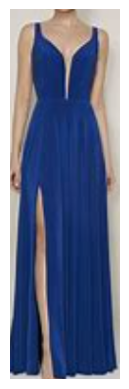

Similaridade com vestido verde:  tensor(0.8257)
Similaridade: 52-13-5277-09246 - Score: 0.99


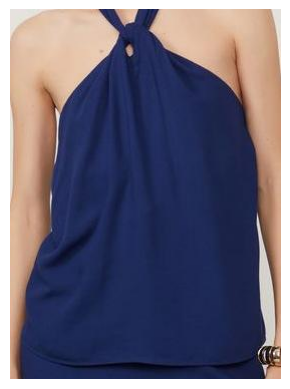

Similaridade: 07-20-6486-09561 - Score: 0.99


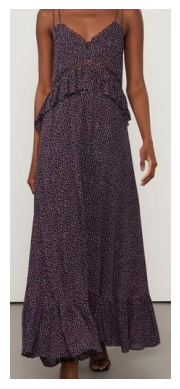

Similaridade: 07-20-6581-04501 - Score: 0.98


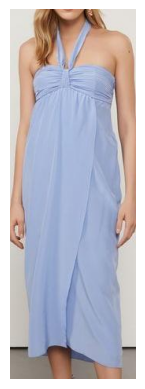


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_CIANO.png


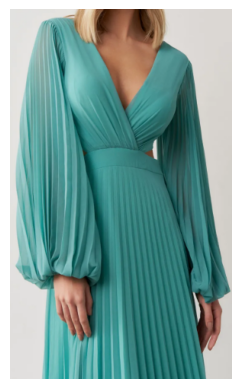

Similaridade com vestido verde:  tensor(0.9133)
Similaridade: 07-20-6821-0300 - Score: 0.98


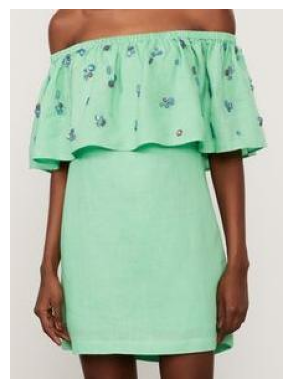

Similaridade: 52-13-5120-0005 - Score: 0.98


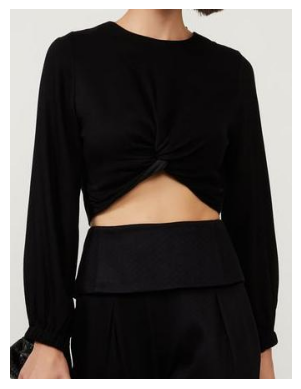

Similaridade: 52-06-0653-0003 - Score: 0.98


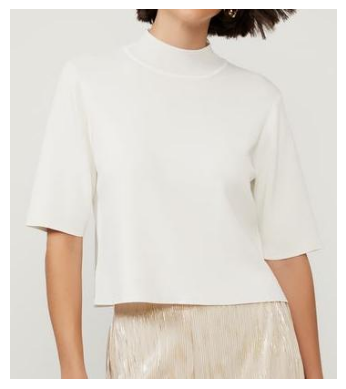


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_LISTRADO.png


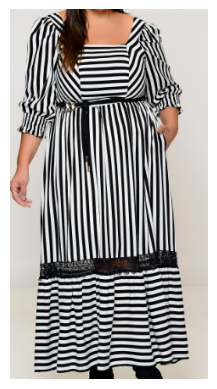

Similaridade com vestido verde:  tensor(0.7508)
Similaridade: 07-20-6337-0003 - Score: 0.97


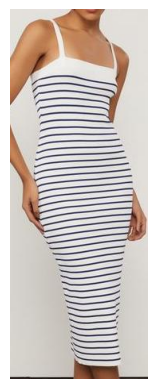

Similaridade: 52-05-1516-09557 - Score: 0.95


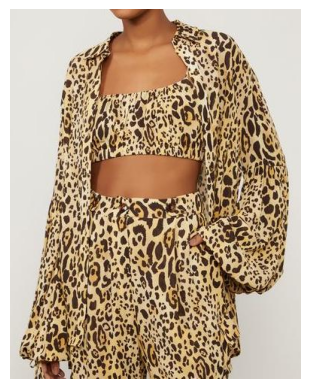

Similaridade: 52-08-0790-0003 - Score: 0.95


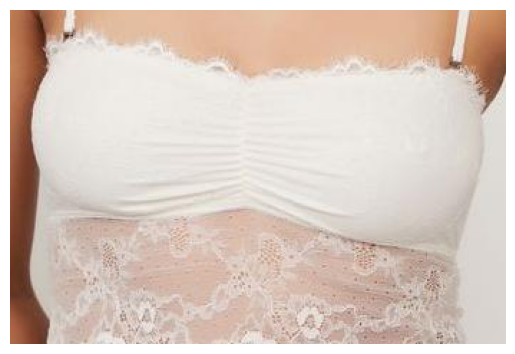


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_MARROM.png


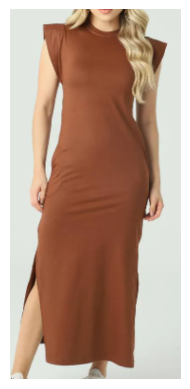

Similaridade com vestido verde:  tensor(0.8894)
Similaridade: 25-11-1108-0600 - Score: 0.96


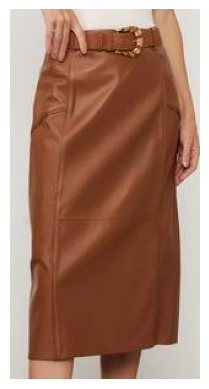

Similaridade: 07-20-6659-09538 - Score: 0.96


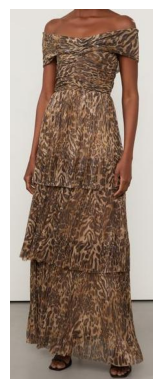

Similaridade: 25-34-1638-09247 - Score: 0.95


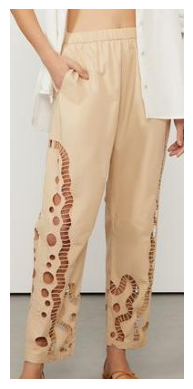


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_MARROM_2.png


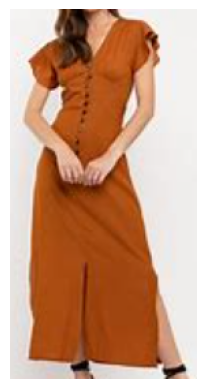

Similaridade com vestido verde:  tensor(0.8872)
Similaridade: 07-99-0036-09260 - Score: 0.97


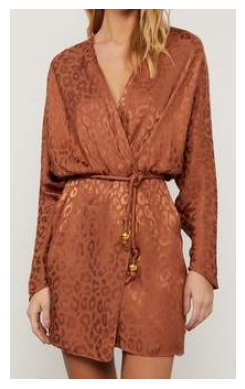

Similaridade: 52-10-5126-0030 - Score: 0.97


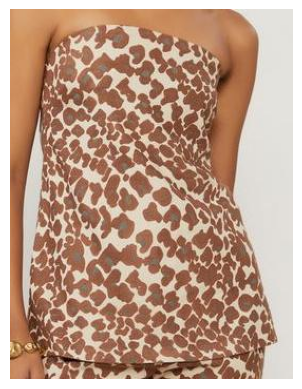

Similaridade: 25-34-1652-6048 - Score: 0.97


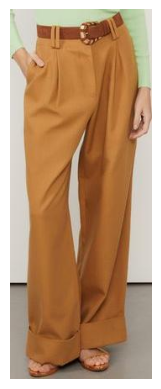


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_ROXO.png


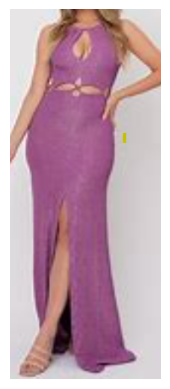

Similaridade com vestido verde:  tensor(0.6154)
Similaridade: 25-34-1675-1974 - Score: 0.96


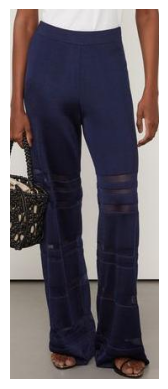

Similaridade: 25-34-2089-04331 - Score: 0.96


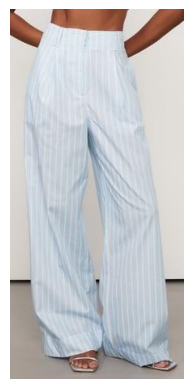

Similaridade: 25-34-1762-0003 - Score: 0.95


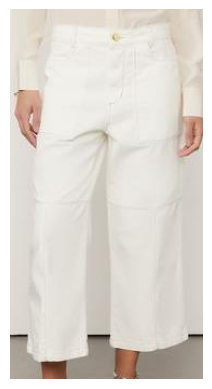


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_VERDE.png


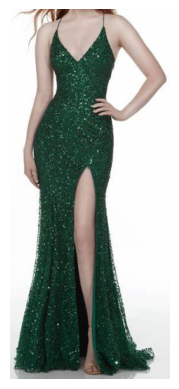

Similaridade com vestido verde:  tensor(0.9342)
Similaridade: 07-20-6676-09253 - Score: 0.96


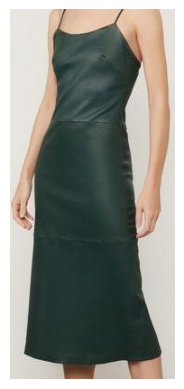

Similaridade: 07-20-6725-09253 - Score: 0.95


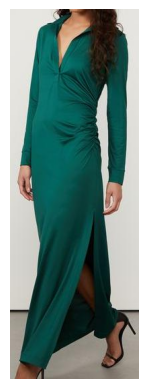

Similaridade: 07-20-6620-09258 - Score: 0.94


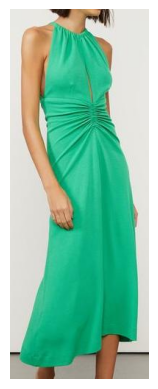


--------------------------------------------------

Imagem de Teste: teste_images/VESTIDO_VERMELHO.png


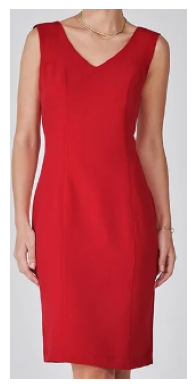

Similaridade com vestido verde:  tensor(0.7907)
Similaridade: 52-15-1331-8259 - Score: 0.97


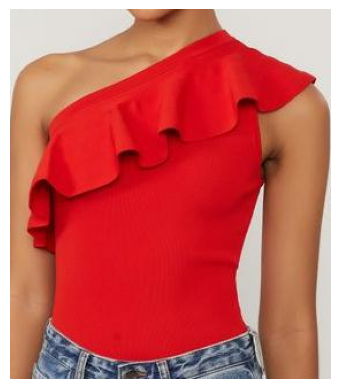

Similaridade: 07-20-6451-8259 - Score: 0.97


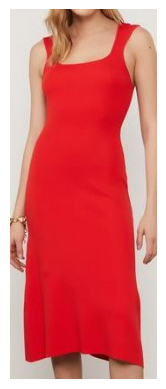

Similaridade: 52-13-5276-8259 - Score: 0.97


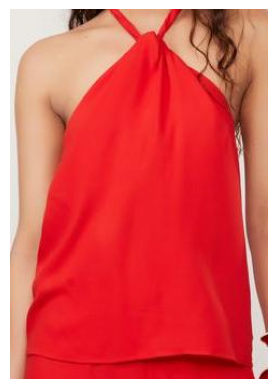


--------------------------------------------------



In [661]:
# Inverter a ordem dos argumentos
cos_sim = util.cos_sim(img_embs_teste_pca, img_embeddings_pca)

# Verificar as dimensões
print(f"Dimensões de cos_sim: {cos_sim.shape}")  # Deve ser (num_test, num_dataset)

# index_verificacao = df_lda.loc[df_lda['id_produto'] == '07-20-6450-2028'].index[0]
index_verificacao = df_lda.loc[df_lda['id_produto'] == '07-20-6333-09253'].index[0]


# para cada imagem teste, retornando as 3 imagens mais similares
for i, scores in enumerate(cos_sim):
    print(f"Imagem de Teste: {df_teste.iloc[i]['image_path']}")
    plot_image(df_teste.iloc[i]['image_path'])

    print("Similaridade com vestido verde: ", scores[index_verificacao])
    
    # Garantir que scores esteja no CPU antes de converter para NumPy
    if isinstance(scores, torch.Tensor):
        scores = scores.cpu().numpy()
    
    # Obter os 3 índices com maiores similaridades
    top_3_indices = scores.argsort()[-3:][::-1]
    
    for idx in top_3_indices:
        similar_id = df.iloc[idx]['id_produto']
        similar_score = scores[idx]
        print(f"Similaridade: {similar_id} - Score: {similar_score:.2f}")
        plot_image(df.iloc[idx]['file_path'])
    
    print("\n" + "-"*50 + "\n")


O PCA está se confundindo bastante em alguns casos, demonstrando um comportamento inferior ao LDA.